Compute spatial correlation (SC)

In [59]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [60]:
from scipy import signal
from scipy.io import loadmat
from scipy.optimize import curve_fit
from pathlib import Path
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import mni_utils as uti

### Paths

In [3]:
base_path = Path("F:\\iEEG_neural_dynamics\\MNIOpen")

# Create folder for storing results
res_path = base_path.joinpath("Results_SC")
res_path.mkdir(parents=True, exist_ok=True)

### Load data

Use just Wakefulness for now

In [17]:
data_path = base_path.joinpath("MatlabFile.mat")
data = loadmat(data_path)
data_W = data["Data_W"].T

###
# Convert data to Dataframe
###

ch_names = data["ChannelName"].squeeze()
ch_types = data["ChannelType"].squeeze()
ch_regs = data["ChannelRegion"].squeeze()
pat_ids = data["Patient"].squeeze()
gender = data["Gender"].squeeze()
age = data["AgeAtTimeOfStudy"].squeeze()
ch_pos = data["ChannelPosition"].squeeze()
regions_map = {i + 1: r[0][0] for i, r in enumerate(data["RegionName"])}
sfreq = data["SamplingFrequency"][0][0]
df_info = pd.DataFrame(
    {
        "pat": pat_ids,
        "chan": [ch[0] for ch in ch_names],
        "type": [t[0] for t in ch_types],
        "region": ch_regs,
        "mni_x": ch_pos[:, 0],
        "mni_y": ch_pos[:, 1],
        "mni_z": ch_pos[:, 2],
    }
)

df_info["region"] = df_info["region"].apply(lambda x: regions_map[x])

# Read data & region info from MNI
df_regions_mni = pd.read_csv(base_path.joinpath("RegionInformation.csv"))
df_regions_mni["Region name"] = df_regions_mni["Region name"].apply(
    lambda x: x.strip("'")
)

print(df_info.shape)
print(data_W.shape)

(1772, 7)
(1772, 13600)


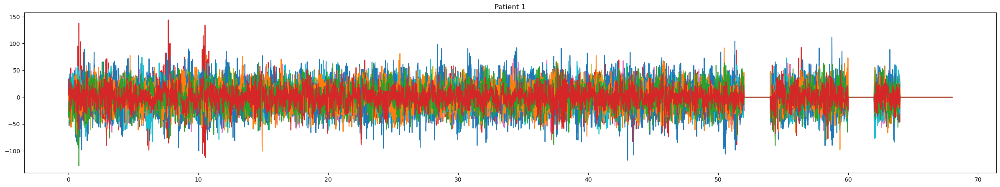

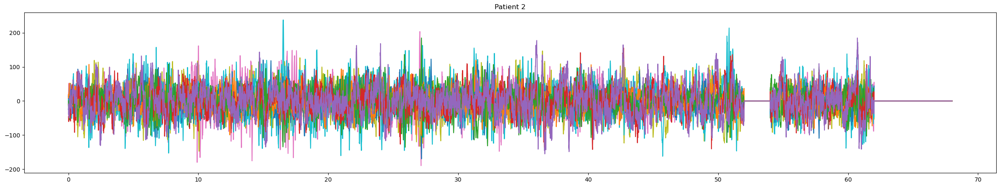

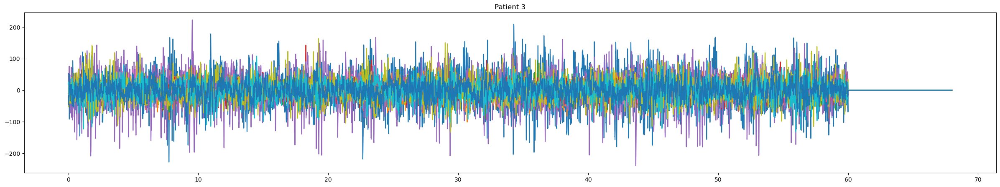

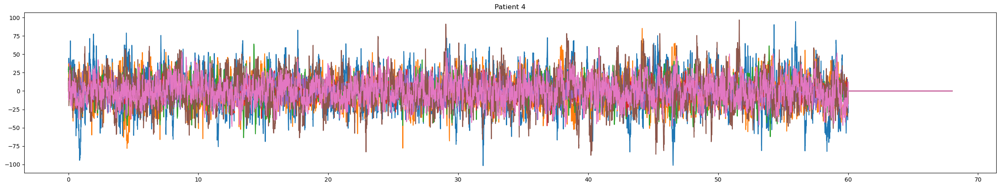

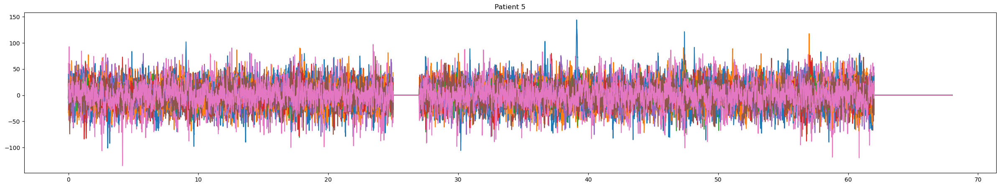

...

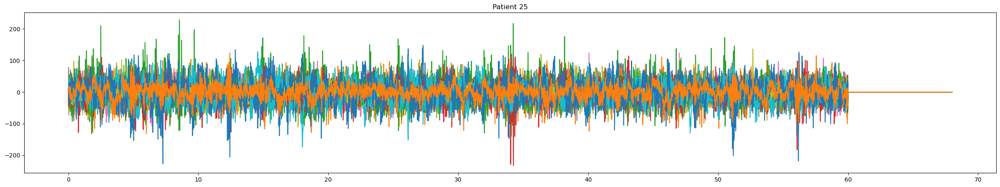

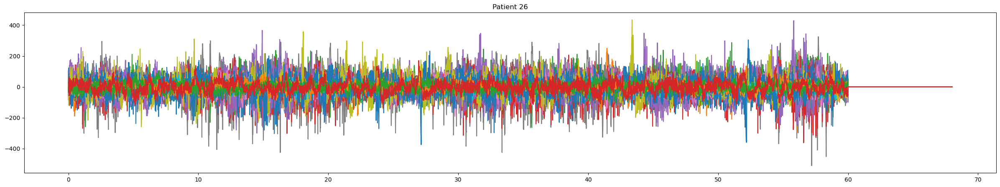

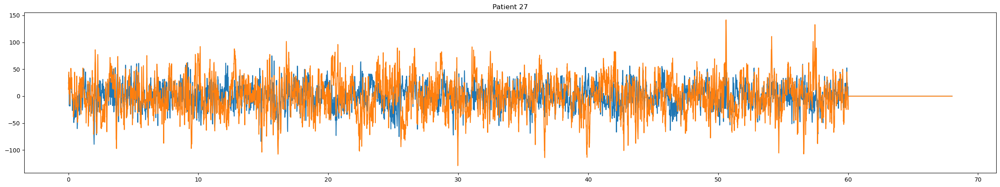

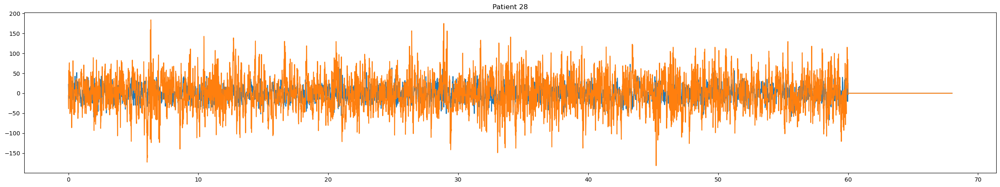

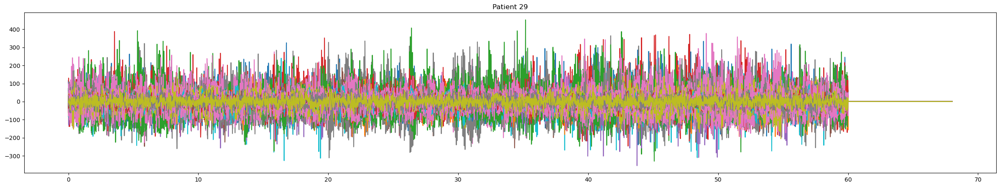

In [6]:
for pat in df_info["pat"].unique():
    idx_pat = np.where(df_info["pat"] == pat)[0]

    plt.figure(figsize=(30, 5))
    t = np.linspace(0, data_W.shape[1] / sfreq, data_W.shape[1])
    plt.plot(t, data_W[idx_pat].T)
    plt.title(f"Patient {pat}")
    plt.show()

## 0. Compute SC for a pair of channels

Take data from 1 patient:

In [61]:
data_pat = data_W[df_info["pat"] == 29]
# Convert to mne Raw
df_info_pat = df_info[df_info["pat"] == 29].reset_index(drop=True)
raw = uti.create_RawMNE(data_pat, df_info_pat["chan"].tolist(), sfreq)
epo = mne.make_fixed_length_epochs(
    raw, duration=1, overlap=0.5, preload=True, verbose=False
).get_data()

Compute first for a pair of channels:

In [92]:
data_ch1 = epo[:, 0]
data_ch2 = epo[:, 1]

corr_all = []
corr_0 = []
corr_max = []
lag_max = []
for i in range(len(data_ch1)):
    ch1_norm = data_ch1[i] / np.linalg.norm(
        data_ch1[i]
    )  # (ch1 - ch1.mean()) / (ch1.std() * len(ch1))
    ch2_norm = data_ch2[i] / np.linalg.norm(
        data_ch2[i]
    )  # (ch2 - ch2.mean()) / ch2.std()
    corr = signal.correlate(ch1_norm, ch2_norm, mode="same")
    lags = signal.correlation_lags(len(ch1_norm), len(ch2_norm), mode="same")
    corr_all.append(corr)
    corr_0.append(corr[lags == 0][0])
    corr_max.append(np.max(corr))
    lag_max.append(lags[np.argmax(corr)])
corr_all = np.array(corr_all)

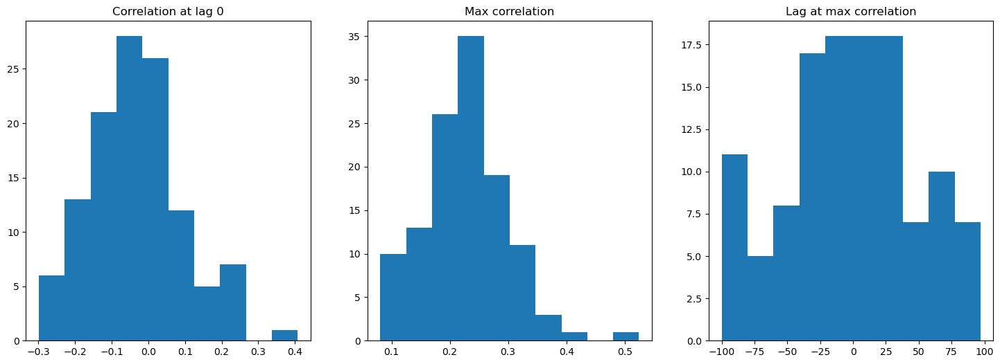

In [93]:
plt.figure(figsize=[18, 6])
plt.subplot(1, 3, 1)
plt.hist(corr_0)
plt.title("Correlation at lag 0")
plt.subplot(1, 3, 2)
plt.hist(corr_max)
plt.title("Max correlation")
plt.subplot(1, 3, 3)
plt.hist(lag_max)
plt.title("Lag at max correlation")
plt.show()

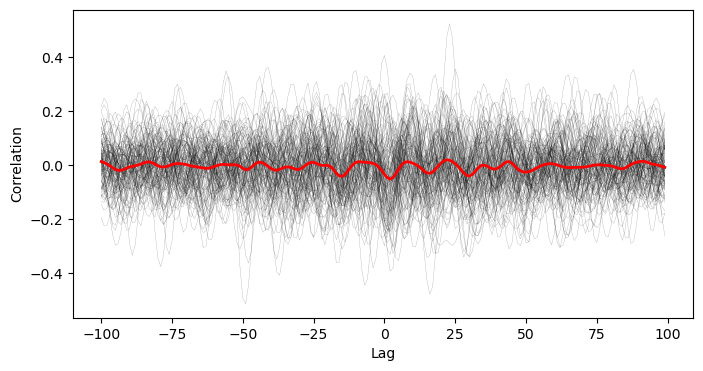

In [94]:
plt.figure(figsize=(8, 4))
plt.plot(lags, corr_all.T, lw=0.2, c="k", alpha=0.4)
plt.plot(lags, np.mean(corr_all, axis=0), lw=2, c="r")
plt.xlabel("Lag")
plt.ylabel("Correlation")
plt.show()

In [95]:
max(np.mean(corr_all, axis=0))

0.020382724832609535

In [97]:
data_ch1 = raw.get_data(0).squeeze()
data_ch2 = raw.get_data(1).squeeze()

# corr_all = []
# corr_0 = []
# corr_max = []
# lag_max = []
# for i in range(len(data_ch1)):
ch1_norm = data_ch1 / np.linalg.norm(
    data_ch1
)  # (ch1 - ch1.mean()) / (ch1.std() * len(ch1))
ch2_norm = data_ch2 / np.linalg.norm(
    data_ch2
)  # (ch2 - ch2.mean()) / ch2.std()
corr_raw = signal.correlate(ch1_norm, ch2_norm, mode="same")
lags_raw = signal.correlation_lags(len(ch1_norm), len(ch2_norm), mode="same")
# corr_all.append(corr)
# corr_0.append(corr[lags == 0][0])
# corr_max.append(np.max(corr))
# lag_max.append(lags[np.argmax(corr)])
# corr_all = np.array(corr_all)

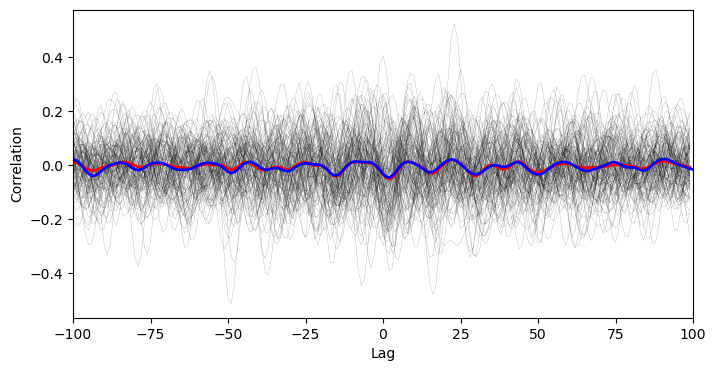

In [98]:
plt.figure(figsize=(8, 4))
plt.plot(lags, corr_all.T, lw=0.2, c="k", alpha=0.4)
plt.plot(lags, np.mean(corr_all, axis=0), lw=2, c="r")
plt.plot(lags_raw, corr_raw, lw=2, c="b")
plt.xlabel("Lag")
plt.ylabel("Correlation")
plt.xlim(-100, 100)
plt.show()

In [99]:
max(corr_raw)

0.05109542466296156

### Gather for a seed and all pairs

In [131]:
df_sc = pd.DataFrame(columns=["ch1", "ch2", "dist", "corr_0", "corr_max", "lag_max"])

data_ch1 = epo[:, 2]

ch1_list = []
ch2_list = []
dist = []
corr_0 = []
corr_max = []
lag_max = []

for i, row in df_info_pat.iterrows():
    ch1 = df_info_pat.loc[2, "chan"]
    ch2 = df_info_pat.loc[i, "chan"]
    ch1_list.append(ch1)
    ch2_list.append(ch2)
    dist.append(
        np.linalg.norm(
            df_info_pat.loc[2, ["mni_x", "mni_y", "mni_z"]]
            - df_info_pat.loc[i, ["mni_x", "mni_y", "mni_z"]]
        )
    )

    if ch1 == ch2:
        corr_0.append(0)
        corr_max.append(0)
        lag_max.append(0)
        continue

    corr_avg = []
    data_ch2 = epo[:, i]
    for j in range(len(data_ch1)):
        ch1_norm = data_ch1[j] / np.linalg.norm(data_ch1[j])
        ch2_norm = data_ch2[j] / np.linalg.norm(data_ch2[j])
        corr = signal.correlate(ch1_norm, ch2_norm, mode="same")
        lags = signal.correlation_lags(len(ch1_norm), len(ch2_norm), mode="same")
        corr_avg.append(corr)
    corr_avg = np.array(corr_avg).mean(axis=0)
    corr_0.append(corr_avg[lags == 0][0])
    corr_max.append(np.max(corr_avg))
    lag_max.append(lags[np.argmax(corr_avg)])

df_sc["ch1"] = ch1_list
df_sc["ch2"] = ch2_list
df_sc["dist"] = dist
df_sc["corr_0"] = corr_0
df_sc["corr_max"] = corr_max
df_sc["lag_max"] = lag_max

In [132]:
df_sc

,ch1,ch2,dist,corr_0,corr_max,lag_max
0,GD029Rv13,GD029Rv1,45.044423,-0.029063,0.019522,44
1,GD029Rv13,GD029Rv12,5.000000,0.900375,0.900375,0
2,GD029Rv13,GD029Rv13,0.000000,0.000000,0.000000,0
3,GD029Rv13,GD029Rs1,24.779023,-0.073021,0.044111,-20
4,GD029Rv13,GD029Rs2,21.563859,-0.071456,0.082936,8
5,GD029Rv13,GD029Rs3,19.748418,-0.036665,0.073065,-9
6,GD029Rv13,GD029Rs4,16.552945,-0.039500,0.057551,-10
7,GD029Rv13,GD029Rs5,15.524175,-0.066096,0.097019,5
8,GD029Rv13,GD029Rs6,15.842980,-0.046409,0.110140,4
9,GD029Rv13,GD029Rs7,15.556349,-0.002807,0.070806,-11


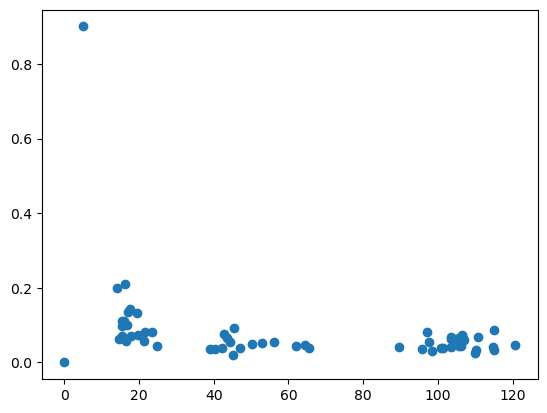

In [133]:
plt.plot(df_sc["dist"], df_sc["corr_max"], "o")

### For all eletrodes pairs together

In [28]:
df_sc = pd.DataFrame(columns=["ch1", "ch2", "dist", "corr_0", "corr_max", "lag_max"])

ch1_list = []
ch2_list = []
dist = []
corr_0 = []
corr_max = []
lag_max = []

# Loop on the "seed" channel
for i in range(len(df_info_pat)):
    data_ch1 = epo[:, i]
    ch1 = df_info_pat.loc[i, "chan"]

    for j in range(i + 1, len(df_info_pat)):
        ch2 = df_info_pat.loc[j, "chan"]
        ch1_list.append(ch1)
        ch2_list.append(ch2)
        dist.append(
            np.linalg.norm(
                df_info_pat.loc[i, ["mni_x", "mni_y", "mni_z"]]
                - df_info_pat.loc[j, ["mni_x", "mni_y", "mni_z"]]
            )
        )

        if ch1 == ch2:
            corr_0.append(0)
            corr_max.append(0)
            lag_max.append(0)
            continue

        corr_avg = []
        data_ch2 = epo[:, j]

        # Loop over epochs
        for k in range(len(data_ch1)):
            ch1_norm = data_ch1[k] / np.linalg.norm(data_ch1[k])
            ch2_norm = data_ch2[k] / np.linalg.norm(data_ch2[k])
            corr = signal.correlate(ch1_norm, ch2_norm, mode="same")
            lags = signal.correlation_lags(len(ch1_norm), len(ch2_norm), mode="same")
            corr_avg.append(corr)
        corr_avg = np.array(corr_avg).mean(axis=0)
        corr_0.append(corr_avg[lags == 0][0])
        corr_max.append(np.max(corr_avg))
        lag_max.append(lags[np.argmax(corr_avg)])

df_sc["ch1"] = ch1_list
df_sc["ch2"] = ch2_list
df_sc["dist"] = dist
df_sc["corr_0"] = corr_0
df_sc["corr_max"] = corr_max
df_sc["lag_max"] = lag_max

NameError: name 'df_info_pat' is not defined

In [32]:
df_sc

,ch1,ch2,dist,corr_0,corr_max,lag_max
0,GD001Lc_11,GD001Lc_12,4.472136,0.380825,0.380825,0
1,GD001Lc_11,GD001Lc_13,7.000000,0.247841,0.247841,0
2,GD001Lc_11,GD001Lc_14,12.041595,-0.319450,0.068356,7
3,GD001Lc_11,GD001Lo_1,97.005155,0.000325,0.044060,-58
4,GD001Lc_11,GD001Lo_2,95.336247,-0.020017,0.023040,-80
...,...,...,...,...,...,...
86,GD001Lv_3,GD001Lv_5,6.164414,-0.295399,0.060071,-15
87,GD001Lv_3,GD001Lv_6,10.099505,-0.136850,0.030843,21
88,GD001Lv_4,GD001Lv_5,3.391165,0.046767,0.066544,-27
89,GD001Lv_4,GD001Lv_6,7.176350,-0.036032,0.034935,24


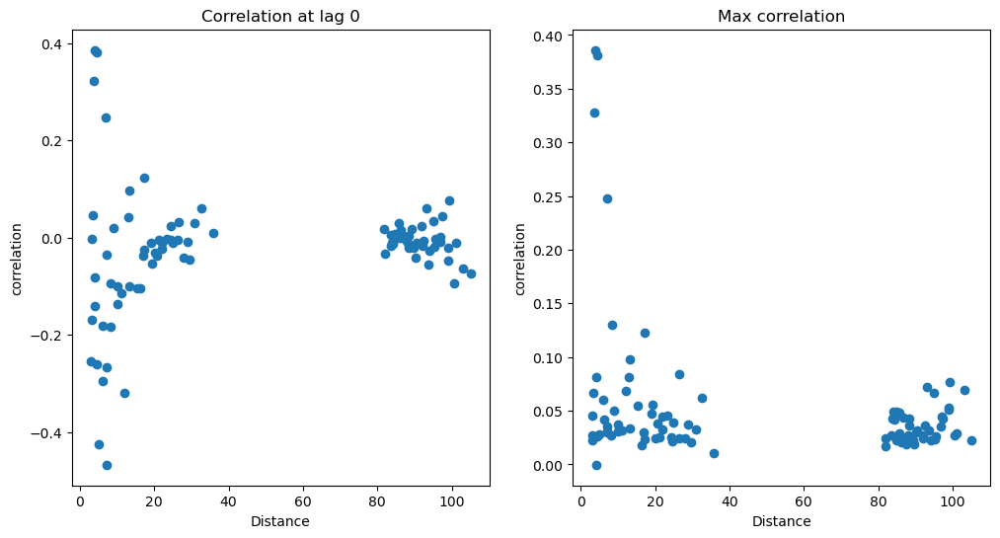

In [35]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(df_sc["dist"], df_sc["corr_0"], "o")
plt.xlabel("Distance")
plt.ylabel("correlation")
plt.title("Correlation at lag 0")
plt.subplot(1, 2, 2)
plt.plot(df_sc["dist"], df_sc["corr_max"], "o")
plt.xlabel("Distance")
plt.ylabel("correlation")
plt.title("Max correlation")
plt.show()

### Compute for all patients

In [30]:
pat_list = []
ch1_list = []
ch2_list = []
dist = []
corr_0 = []
corr_max = []
lag_max = []

for pat in df_info["pat"].unique():
    print(pat, end="|")

    data_pat = data_W[df_info["pat"] == pat]
    # Convert to mne Raw
    df_info_pat = df_info[df_info["pat"] == pat].reset_index(drop=True)
    raw = uti.create_RawMNE(data_pat, df_info_pat["chan"].tolist(), sfreq)
    epo = mne.make_fixed_length_epochs(
        raw, duration=1, overlap=0.5, preload=True, verbose=False
    ).get_data()

    # Loop on the "seed" channel
    for i in range(len(df_info_pat)):
        data_ch1 = epo[:, i]
        ch1 = df_info_pat.loc[i, "chan"]

        for j in range(i + 1, len(df_info_pat)):
            ch2 = df_info_pat.loc[j, "chan"]
            pat_list.append(pat)
            ch1_list.append(ch1)
            ch2_list.append(ch2)
            dist.append(
                np.linalg.norm(
                    df_info_pat.loc[i, ["mni_x", "mni_y", "mni_z"]]
                    - df_info_pat.loc[j, ["mni_x", "mni_y", "mni_z"]]
                )
            )

            if ch1 == ch2:
                corr_0.append(0)
                corr_max.append(0)
                lag_max.append(0)
                continue

            corr_avg = []
            data_ch2 = epo[:, j]

            # Loop over epochs
            for k in range(len(data_ch1)):
                ch1_norm = (data_ch1[k] - data_ch1[k].mean()) / np.linalg.norm(
                    data_ch1[k]
                )
                ch2_norm = (data_ch2[k] - data_ch2[k].mean()) / np.linalg.norm(
                    data_ch2[k]
                )
                corr = signal.correlate(ch1_norm, ch2_norm, mode="same")
                lags = signal.correlation_lags(
                    len(ch1_norm), len(ch2_norm), mode="same"
                )
                corr_avg.append(corr)
            corr_avg = np.array(corr_avg).mean(axis=0)
            corr_0.append(corr_avg[lags == 0][0])
            corr_max.append(np.max(corr_avg))
            lag_max.append(lags[np.argmax(corr_avg)])

df_sc = pd.DataFrame(columns=["ch1", "ch2", "dist", "corr_0", "corr_max", "lag_max"])
df_sc["pat"] = pat_list
df_sc["ch1"] = ch1_list
df_sc["ch2"] = ch2_list
df_sc["dist"] = dist
df_sc["corr_0"] = corr_0
df_sc["corr_max"] = corr_max
df_sc["lag_max"] = lag_max

1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|87|88|89|90|91|92|93|94|96|97|98|99|100|101|102|103|104|106|107|108|109|110|

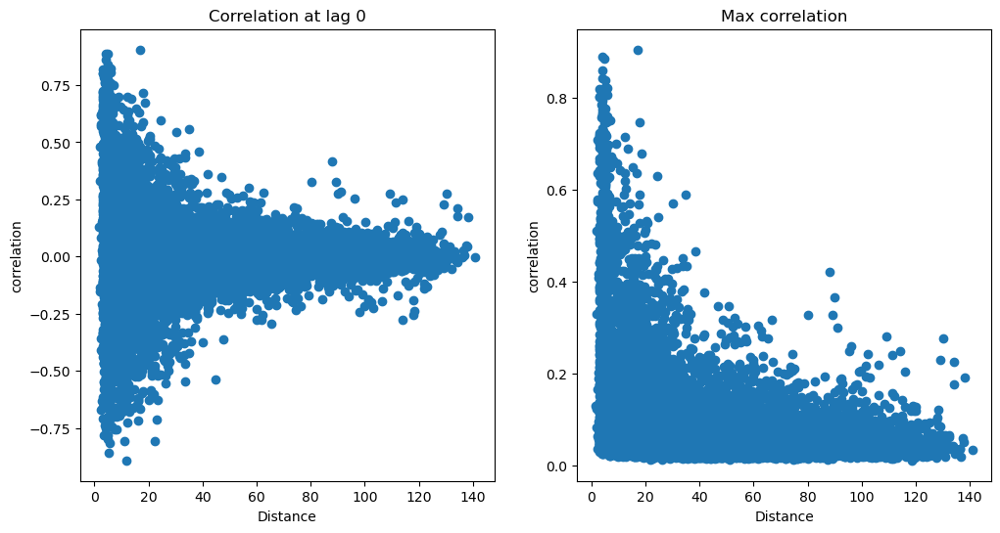

In [31]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(df_sc["dist"], df_sc["corr_0"], "o")
plt.xlabel("Distance")
plt.ylabel("correlation")
plt.title("Correlation at lag 0")
plt.subplot(1, 2, 2)
plt.plot(df_sc["dist"], df_sc["corr_max"], "o")
plt.xlabel("Distance")
plt.ylabel("correlation")
plt.title("Max correlation")
plt.show()

[10.27910077  0.2812165   0.05093958]


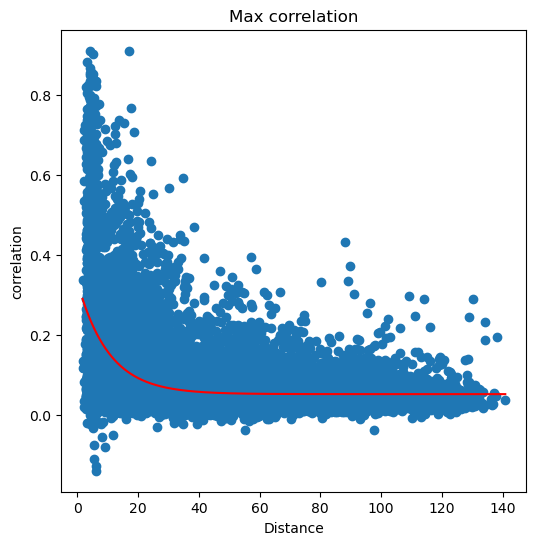

In [52]:
from scipy.optimize import curve_fit


def _exp_decay(x, k, a, b):
    return a * np.exp(-x / k) + b


popt, pcov = curve_fit(
    _exp_decay,
    df_sc["dist"],
    df_sc["corr_max"],
    bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
)
print(popt)

plt.figure(figsize=(6, 6))
plt.plot(df_sc["dist"], df_sc["corr_max"], "o")
plt.plot(
    df_sc["dist"].sort_values(), _exp_decay(df_sc["dist"].sort_values(), *popt), "r-"
)
plt.xlabel("Distance")
plt.ylabel("correlation")
plt.title("Max correlation")
plt.show()

#### Binning:

In [55]:
df_sc["dist"].min(), df_sc["dist"].max()

(1.704772712123232, 140.90912114167193)

In [83]:
bins_cat, bins = pd.cut(df_sc["dist"], bins=np.arange(141), retbins=True)
df_sc_bin_avg = pd.DataFrame(columns=["dist", "bin", "corr_0", "corr_max"])
df_sc_bin_sem = pd.DataFrame(columns=["dist", "corr_0_sem", "corr_max_sem"])
df_sc_bin_avg["dist"] = bins_cat
df_sc_bin_sem["dist"] = bins_cat

df_sc_bin_avg["corr_0"] = df_sc["corr_0"].abs()
df_sc_bin_avg["corr_max"] = df_sc["corr_max"]
df_sc_bin_sem["corr_0_sem"] = df_sc["corr_0"].abs()
df_sc_bin_sem["corr_max_sem"] = df_sc["corr_max"]
df_sc_bin_avg = df_sc_bin_avg.groupby("dist").mean()
df_sc_bin_avg["bin"] = bins[:-1] + np.diff(bins) / 2
df_sc_bin_avg.reset_index(inplace=True, drop=True)
df_sc_bin_sem = df_sc_bin_sem.groupby("dist").sem()
df_sc_bin_sem.reset_index(inplace=True, drop=True)
df_sc_bin = pd.concat([df_sc_bin_avg, df_sc_bin_sem], axis=1)
df_sc_bin.dropna(inplace=True)

C:\Users\ricca\AppData\Local\Temp\ipykernel_20132\1457905303.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_avg = df_sc_bin_avg.groupby("dist").mean()
C:\Users\ricca\AppData\Local\Temp\ipykernel_20132\1457905303.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_sem = df_sc_bin_sem.groupby("dist").sem()


In [84]:
df_sc_bin

,bin,corr_0,corr_max,corr_0_sem,corr_max_sem
1,1.5,0.136865,0.124447,0.004640,0.008128
2,2.5,0.325096,0.250546,0.032395,0.031224
3,3.5,0.331391,0.276912,0.014868,0.015145
4,4.5,0.309317,0.236897,0.012019,0.011803
5,5.5,0.335885,0.241383,0.015361,0.014292
...,...,...,...,...,...
132,132.5,0.024945,0.053292,0.012473,0.005383
133,133.5,0.022693,0.033789,0.011505,0.011652
134,134.5,0.141666,0.147526,0.059739,0.063128
136,136.5,0.007132,0.029434,0.004409,0.004264


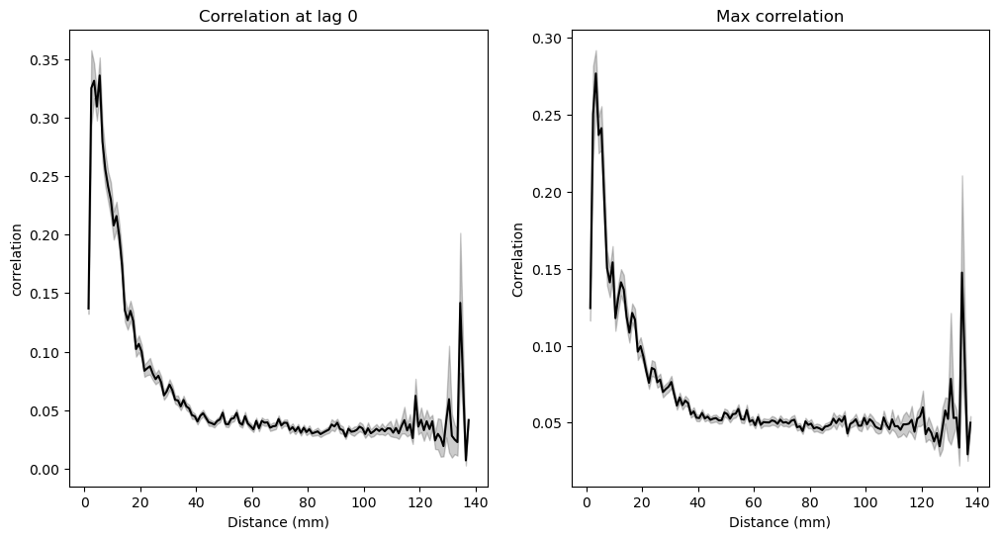

In [85]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(df_sc_bin["bin"], df_sc_bin["corr_0"], "k-")
plt.fill_between(
    df_sc_bin["bin"],
    df_sc_bin["corr_0"] - df_sc_bin["corr_0_sem"],
    df_sc_bin["corr_0"] + df_sc_bin["corr_0_sem"],
    color="k",
    alpha=0.2,
)
plt.xlabel("Distance (mm)")
plt.ylabel("correlation")
plt.title("Correlation at lag 0")
plt.subplot(1, 2, 2)
plt.plot(df_sc_bin["bin"], df_sc_bin["corr_max"], "k-")
plt.fill_between(
    df_sc_bin["bin"],
    df_sc_bin["corr_max"] - df_sc_bin["corr_max_sem"],
    df_sc_bin["corr_max"] + df_sc_bin["corr_max_sem"],
    color="k",
    alpha=0.2,
)
plt.xlabel("Distance (mm)")
plt.ylabel("Correlation")
plt.title("Max correlation")
plt.show()

## Check for different sleep stages

In [5]:
df_info

,pat,chan,type,region,mni_x,mni_y,mni_z
0,1,GD001Lc_11,D,Middle temporal gyrus,-56.000000,-37.000000,-2.000000
1,1,GD001Lc_12,D,Middle temporal gyrus,-60.000000,-37.000000,-4.000000
2,1,GD001Lc_13,D,Middle temporal gyrus,-63.000000,-37.000000,-2.000000
3,1,GD001Lc_14,D,Middle temporal gyrus,-68.000000,-38.000000,-2.000000
4,1,GD001Lo_1,D,Medial frontal cortex,-1.000000,42.000000,-14.000000
...,...,...,...,...,...,...,...
1767,110,NG110RG614,G,Postcentral gyrus (including medial segment),64.958333,-6.500000,13.666667
1768,110,NG110RG64,G,Frontal operculum,48.464286,27.464286,-1.285714
1769,110,NG110RG65,G,Frontal operculum,52.535714,15.035714,-0.214286
1770,110,NG110RI101,G,Supplementary motor cortex,1.035714,-2.047619,48.380952


In [11]:
df_sc_stages = {}
df_sc_bin_stages = {}

for stage in ["W", "N3", "R"]:
    print(stage)

    # Select stage data
    data_stage = data["Data_" + stage].T

    # Compute spatial correlation dataframe
    df_sc = uti.compute_SC(data_stage, df_info, df_regions_mni, sfreq)
    df_sc_stages[stage] = df_sc
    # Save
    df_sc.to_csv(res_path.joinpath(f"SC_{stage}.csv"))

    # Compute binned spatial correlations
    df_sc_bin_stages[stage] = uti.compute_sc_bin(df_sc, bins=np.arange(121))

W
1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|87|88|89|90|91|92|93|94|96|97|98|99|100|101|102|103|104|106|107|108|109|110|

c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:292: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_avg = df_sc_bin_avg.groupby("dist").mean()
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:295: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_sem = df_sc_bin_sem.groupby("dist").sem()


N3
1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|87|88|89|90|91|92|93|94|96|97|98|99|100|101|102|103|104|106|107|108|109|110|

c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:292: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_avg = df_sc_bin_avg.groupby("dist").mean()
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:295: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_sem = df_sc_bin_sem.groupby("dist").sem()


R
1|2|3|4|5|6|7|8|9|10|11|12|13|14|15|16|17|18|19|20|21|22|23|24|25|26|27|28|29|30|31|32|33|34|35|36|37|38|39|40|41|42|43|44|45|46|47|48|49|50|52|53|54|55|56|57|58|59|60|61|62|63|64|65|66|67|68|69|70|71|72|73|74|75|76|77|78|79|80|81|82|83|84|85|87|88|89|90|91|92|93|94|96|97|98|99|100|101|102|103|104|106|107|108|109|110|

c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:292: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_avg = df_sc_bin_avg.groupby("dist").mean()
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:295: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sc_bin_sem = df_sc_bin_sem.groupby("dist").sem()


Load if already computed:

In [230]:
df_sc_stages = {}
df_sc_bin_stages = {}

for stage in ["W", "N3", "R"]:
    print(stage)

    # Select stage data
    data_stage = data["Data_" + stage].T

    # Load spatial correlation dataframe
    df_sc_stages[stage] = pd.read_csv(res_path.joinpath(f"SC_{stage}.csv"), index_col=0)

    # Compute binned spatial correlations
    df_sc_bin_stages[stage] = uti.compute_sc_bin(
        df_sc_stages[stage], bins=np.arange(0, 121, 5)
    )

W
N3
R


c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:401: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:404: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py:401: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mn

All data with fit:

In [233]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}

W [10.17853122  0.28889104  0.04927764]
N3 [8.20646086 0.25307204 0.06473372]
R [8.01471925 0.23028708 0.04818166]


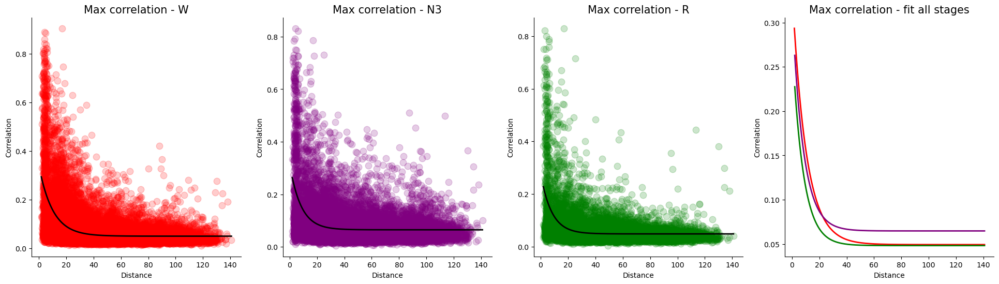

In [13]:
params_max_stages = {}
plt.figure(figsize=(24, 6))
for i, stage in enumerate(["W", "N3", "R"]):
    popt, pcov = curve_fit(
        uti._exp_decay,
        df_sc_stages[stage]["dist"],
        df_sc_stages[stage]["corr_max"],
        bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
    )
    params_max_stages[stage] = popt
    print(stage, popt)

    plt.subplot(1, 4, i + 1)
    plt.plot(
        df_sc_stages[stage]["dist"],
        df_sc_stages[stage]["corr_max"],
        "o",
        c=colors_stage[stage],
        ms=9,
        alpha=0.2,
    )
    plt.plot(
        df_sc_stages[stage]["dist"].sort_values(),
        uti._exp_decay(df_sc_stages[stage]["dist"].sort_values(), *popt),
        "-",
        c="k",
        lw=2,
        zorder=9,
    )
    plt.xlabel("Distance", fontsize=10)
    plt.ylabel("Correlation", fontsize=10)
    plt.title(f"Max correlation - {stage}", fontsize=15)
    sns.despine()
plt.subplot(1, 4, 4)
for stage in ["W", "N3", "R"]:
    plt.plot(
        df_sc_stages[stage]["dist"].sort_values(),
        uti._exp_decay(
            df_sc_stages[stage]["dist"].sort_values(), *params_max_stages[stage]
        ),
        "-",
        c=colors_stage[stage],
        lw=2,
    )
plt.xlabel("Distance", fontsize=10)
plt.ylabel("Correlation", fontsize=10)
plt.title("Max correlation - fit all stages", fontsize=15)
sns.despine()
plt.show()

W [11.48768427  0.40531027  0.03010832]
N3 [10.35970264  0.33860137  0.05848555]
R [10.95520219  0.33035808  0.03477712]


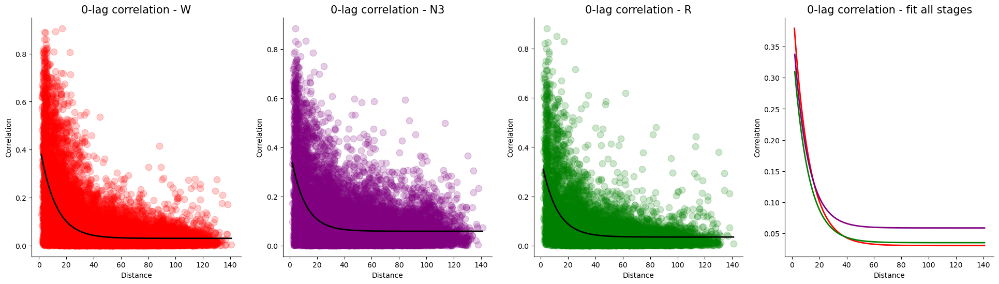

In [33]:
params_0_stages = {}
plt.figure(figsize=(24, 6))
for i, stage in enumerate(["W", "N3", "R"]):
    popt, pcov = curve_fit(
        uti._exp_decay,
        df_sc_stages[stage]["dist"],
        df_sc_stages[stage]["corr_0"].abs(),
        bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
    )
    params_0_stages[stage] = popt
    print(stage, popt)

    plt.subplot(1, 4, i + 1)
    plt.plot(
        df_sc_stages[stage]["dist"],
        df_sc_stages[stage]["corr_0"].abs(),
        "o",
        c=colors_stage[stage],
        ms=9,
        alpha=0.2,
    )
    plt.plot(
        df_sc_stages[stage]["dist"].sort_values(),
        uti._exp_decay(df_sc_stages[stage]["dist"].sort_values(), *popt),
        "-",
        c="k",
        lw=2,
        zorder=9,
    )
    plt.xlabel("Distance", fontsize=10)
    plt.ylabel("Correlation", fontsize=10)
    plt.title(f"0-lag correlation - {stage}", fontsize=15)
    sns.despine()
plt.subplot(1, 4, 4)
for stage in ["W", "N3", "R"]:
    plt.plot(
        df_sc_stages[stage]["dist"].sort_values(),
        uti._exp_decay(
            df_sc_stages[stage]["dist"].sort_values(), *params_0_stages[stage]
        ),
        "-",
        c=colors_stage[stage],
        lw=2,
    )
plt.xlabel("Distance", fontsize=10)
plt.ylabel("Correlation", fontsize=10)
plt.title("0-lag correlation - fit all stages", fontsize=15)
sns.despine()

plt.show()

Binned plot:

In [228]:
np.diff(df_sc_bin_stages["W"]["corr_max"])

array([ 1.21740833e-01,  2.76419330e-02, -3.62898557e-02,  8.77766868e-03,
       -4.79173589e-02, -4.81661310e-02, -8.10787777e-03,  1.06359205e-02,
       -3.47248079e-02,  1.35677405e-02,  7.07284053e-03, -6.60357030e-03,
       -1.70630746e-02, -9.75121599e-03,  1.04761702e-02, -3.17688602e-03,
       -1.92466481e-02,  3.54882148e-03, -7.02956805e-03, -1.04036970e-02,
       -5.56528240e-03,  8.42159179e-03, -2.48673955e-03, -7.44512877e-03,
        2.58672684e-03, -7.68355142e-03,  5.96714376e-05,  3.07410889e-03,
        2.38569988e-03, -8.24427809e-03, -6.75877943e-03,  4.63997745e-03,
       -4.61130861e-03,  3.21240393e-03, -2.11320339e-03, -5.94335554e-03,
        2.13154336e-03, -4.55293323e-03, -8.31587581e-04,  2.68876767e-03,
       -2.01425098e-03,  9.28905786e-04, -3.30374006e-03,  1.27471302e-03,
       -2.83583393e-04, -4.53412566e-04, -2.54887689e-04,  4.71248935e-03,
       -1.26424776e-03, -1.65819304e-03,  2.08670534e-03,  6.41174278e-04,
        2.37956100e-03, -

In [231]:
df_sc_bin_stages["W"]["bin"]

0       2.5
1       7.5
2      12.5
3      17.5
4      22.5
5      27.5
6      32.5
7      37.5
8      42.5
9      47.5
10     52.5
11     57.5
12     62.5
13     67.5
14     72.5
15     77.5
16     82.5
17     87.5
18     92.5
19     97.5
20    102.5
21    107.5
22    112.5
23    117.5
Name: bin, dtype: float64

W [11.7850356   0.25044583  0.04735319]
N3 [11.05788834  0.18603954  0.06219468]
R [15.10916747  0.11802002  0.04332318]


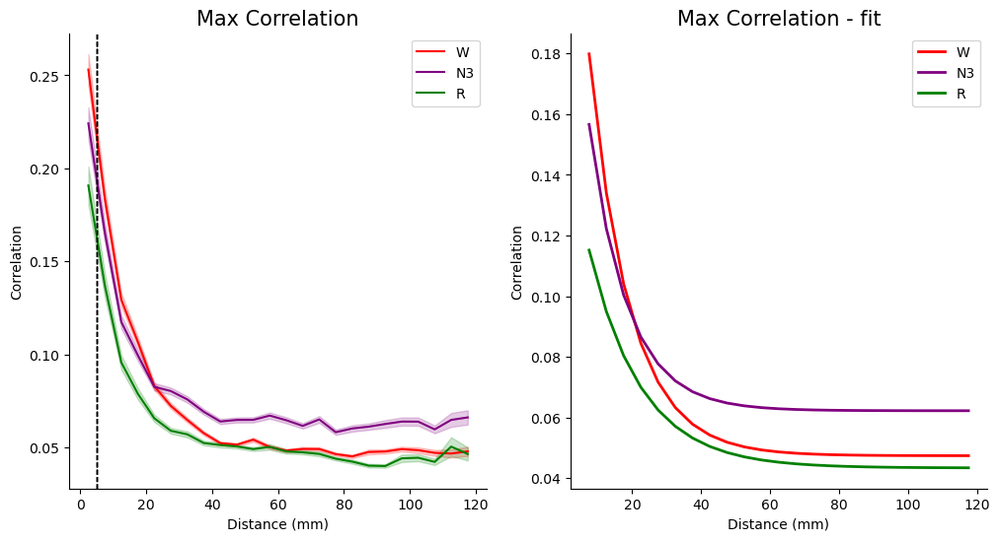

In [234]:
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
for stage in ["W", "N3", "R"]:
    x = df_sc_bin_stages[stage]["bin"][df_sc_bin_stages[stage]["bin"] > 5]
    y = df_sc_bin_stages[stage]["corr_max"][df_sc_bin_stages[stage]["bin"] > 5]
    y_err = df_sc_bin_stages[stage]["corr_max_sem"][df_sc_bin_stages[stage]["bin"] > 5]
    popt, pcov = curve_fit(
        uti._exp_decay,
        x,
        y,
        sigma=y_err,
        bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
    )
    print(stage, popt)

    # Plot of data
    axs[0].plot(
        df_sc_bin_stages[stage]["bin"],
        df_sc_bin_stages[stage]["corr_max"],
        "-",
        c=colors_stage[stage],
        label=stage,
    )
    axs[0].fill_between(
        df_sc_bin_stages[stage]["bin"],
        df_sc_bin_stages[stage]["corr_max"] - df_sc_bin_stages[stage]["corr_max_sem"],
        df_sc_bin_stages[stage]["corr_max"] + df_sc_bin_stages[stage]["corr_max_sem"],
        color=colors_stage[stage],
        alpha=0.2,
    )
    axs[0].axvline(5, c="k", ls="--", lw=1)
    axs[0].set_xlabel("Distance (mm)", fontsize=10)
    axs[0].set_ylabel("Correlation", fontsize=10)
    axs[0].set_title("Max Correlation", fontsize=15)
    axs[0].legend()
    axs[0].spines[["top", "right"]].set_visible(False)

    # Plot of fit
    axs[1].plot(
        x, uti._exp_decay(x, *popt), "-", c=colors_stage[stage], lw=2, label=stage
    )
    axs[1].set_xlabel("Distance (mm)", fontsize=10)
    axs[1].set_ylabel("Correlation", fontsize=10)
    axs[1].set_title("Max Correlation - fit", fontsize=15)
    axs[1].legend()
    axs[1].spines[["top", "right"]].set_visible(False)

plt.show()

W [11.22333798  0.42338984  0.02975437]
N3 [11.47138818  0.30986467  0.05579894]
R [14.48460635  0.25353116  0.02851936]


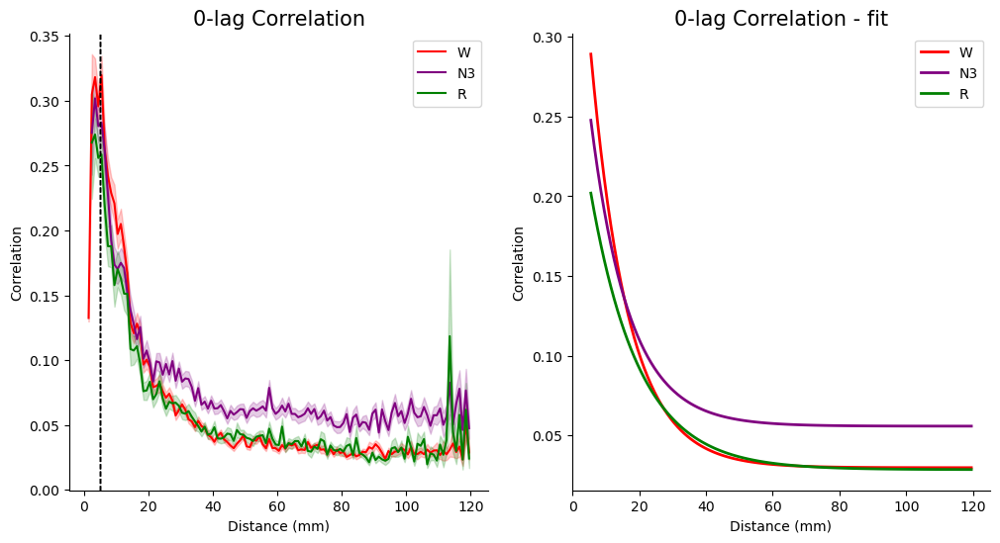

In [36]:
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
for stage in ["W", "N3", "R"]:
    x = df_sc_bin_stages[stage]["bin"][df_sc_bin_stages[stage]["bin"] > 5]
    y = df_sc_bin_stages[stage]["corr_0"][df_sc_bin_stages[stage]["bin"] > 5]
    y_err = df_sc_bin_stages[stage]["corr_0_sem"][df_sc_bin_stages[stage]["bin"] > 5]
    popt, pcov = curve_fit(
        uti._exp_decay,
        x,
        y,
        sigma=y_err,
        bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
    )
    print(stage, popt)

    # Plot of data
    axs[0].plot(
        df_sc_bin_stages[stage]["bin"],
        df_sc_bin_stages[stage]["corr_0"],
        "-",
        c=colors_stage[stage],
        label=stage,
    )
    axs[0].fill_between(
        df_sc_bin_stages[stage]["bin"],
        df_sc_bin_stages[stage]["corr_0"] - df_sc_bin_stages[stage]["corr_0_sem"],
        df_sc_bin_stages[stage]["corr_0"] + df_sc_bin_stages[stage]["corr_0_sem"],
        color=colors_stage[stage],
        alpha=0.2,
    )
    axs[0].axvline(5, c="k", ls="--", lw=1)
    axs[0].set_xlabel("Distance (mm)", fontsize=10)
    axs[0].set_ylabel("Correlation", fontsize=10)
    axs[0].set_title("0-lag Correlation", fontsize=15)
    axs[0].legend()
    axs[0].spines[["top", "right"]].set_visible(False)

    # Plot of fit
    axs[1].plot(
        x, uti._exp_decay(x, *popt), "-", c=colors_stage[stage], lw=2, label=stage
    )
    axs[1].set_xlabel("Distance (mm)", fontsize=10)
    axs[1].set_ylabel("Correlation", fontsize=10)
    axs[1].set_title("0-lag Correlation - fit", fontsize=15)
    axs[1].legend()
    axs[1].spines[["top", "right"]].set_visible(False)

plt.show()

Considerations for max and 0-lag correlations:
1. NREM3 mantains higher correlation at higher distances
2. Wake is more correlated at short distances than NREM3 and REM (higher "amplitude" value)
3. NREM3 has a faster decay in space than Wake and REM, unsure for Wake-REM as it depends on the binning

### Check profiles for the different lobes / regions

First, plot one figure per stage, across lobes:

W
Temporal [9.74433108 0.31488371 0.04818809]
Frontal [10.71863287  0.28112211  0.04935841]
Insula [10.22885666  0.22120421  0.05266569]
Occipital [14.85471067  0.2821408   0.03854398]
Parietal [9.0535072  0.30977429 0.04680906]


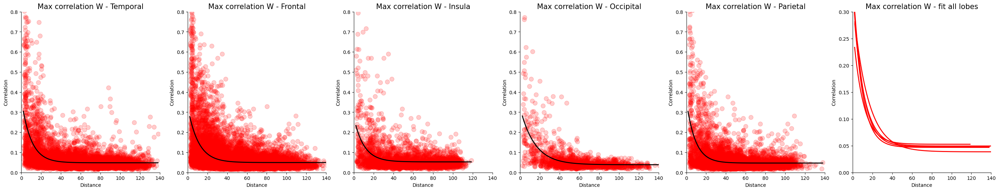

N3
Frontal [7.74548238 0.28248956 0.06687918]
Insula [12.09219358  0.16602202  0.06167141]
Temporal [8.05539514 0.25338231 0.06031131]
Occipital [14.18043006  0.19423316  0.04692294]
Parietal [5.96505406 0.30225734 0.06291046]


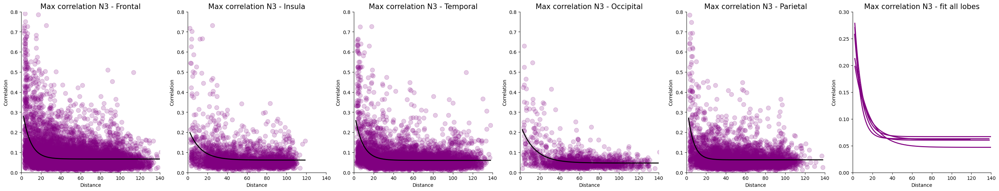

R
Frontal [8.06045132 0.2503727  0.04805759]
Parietal [4.92175289 0.31681132 0.04852216]
Temporal [7.65928926 0.21423715 0.04560192]
Occipital [13.30037584  0.1939068   0.040551  ]
Insula [9.84861479 0.20631544 0.04474047]


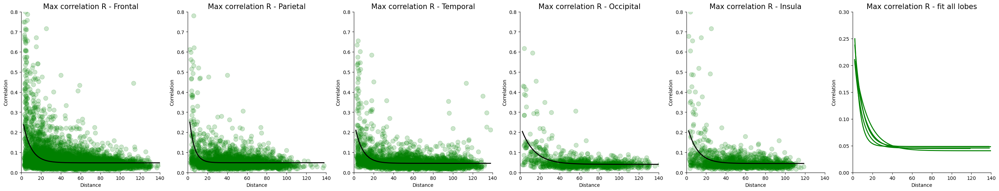

In [28]:
for stage in ["W", "N3", "R"]:
    print(stage)
    df_sc_stage = df_sc_stages[stage]
    # params_max_lobes = {}
    fig, axs = plt.subplots(1, 6, figsize=(36, 6))

    for i, lobe in enumerate(df_sc_stage["lobe1"].unique()):
        df_sc_stage_lobe = df_sc_stage[
            (df_sc_stage["lobe1"] == lobe) | (df_sc_stage["lobe2"] == lobe)
        ]
        popt, pcov = curve_fit(
            uti._exp_decay,
            df_sc_stage_lobe["dist"],
            df_sc_stage_lobe["corr_max"],
            bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
        )
        # params_max_lobes[lobe] = popt
        print(lobe, popt)

        # Plot of data
        axs[i].plot(
            df_sc_stage_lobe["dist"],
            df_sc_stage_lobe["corr_max"],
            "o",
            c=colors_stage[stage],
            ms=9,
            alpha=0.2,
        )
        axs[i].plot(
            df_sc_stage_lobe["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_lobe["dist"].sort_values(), *popt),
            "-",
            c="k",
            lw=2,
            zorder=9,
        )
        axs[i].set_ylim(0, 0.8)
        axs[i].set_xlim(0, 140)
        axs[i].set_xlabel("Distance", fontsize=10)
        axs[i].set_ylabel("Correlation", fontsize=10)
        axs[i].set_title(f"Max correlation {stage} - {lobe}", fontsize=15)
        axs[i].spines[["top", "right"]].set_visible(False)

        # Plot of fit
        axs[-1].plot(
            df_sc_stage_lobe["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_lobe["dist"].sort_values(), *popt),
            "-",
            c=colors_stage[stage],
            lw=2,
        )
        axs[-1].set_ylim(0, 0.3)
        axs[-1].set_xlim(0, 140)
        axs[-1].set_xlabel("Distance", fontsize=10)
        axs[-1].set_ylabel("Correlation", fontsize=10)
        axs[-1].set_title(f"Max correlation {stage} - fit all lobes", fontsize=15)
        # sns.despine(fig, axs[-1])
        axs[-1].spines[["top", "right"]].set_visible(False)
    plt.show()

Differences:
1. Occipital lobe has the slowest decay and lowest SC at higher distances across stages; Parietal has the fastest decay across stages.
2. Wake and REM are generally more similar than NREM3.
3. Frontal is quite correlated at higher distances.

Second, plot one figure per lobe, across stages:

Frontal
W [10.71863287  0.28112211  0.04935841]
N3 [7.74548238 0.28248956 0.06687918]
R [8.06045132 0.2503727  0.04805759]


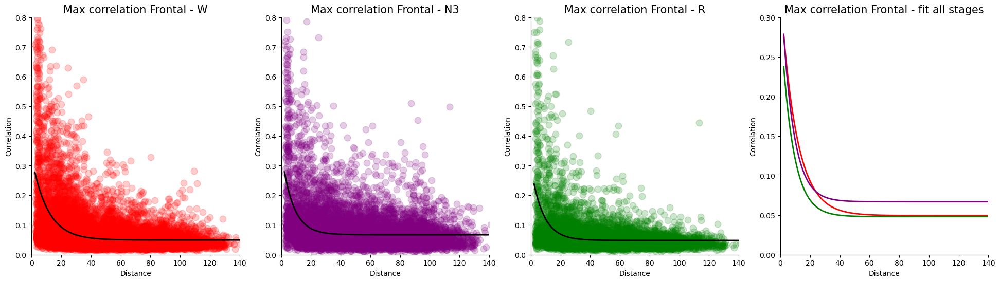

Parietal
W [9.0535072  0.30977429 0.04680906]
N3 [5.96505406 0.30225734 0.06291046]
R [4.92175289 0.31681132 0.04852216]


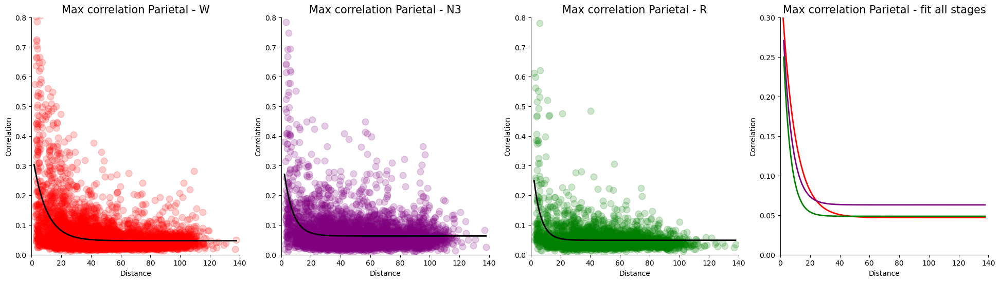

Temporal
W [9.74433108 0.31488371 0.04818809]
N3 [8.05539514 0.25338231 0.06031131]
R [7.65928926 0.21423715 0.04560192]


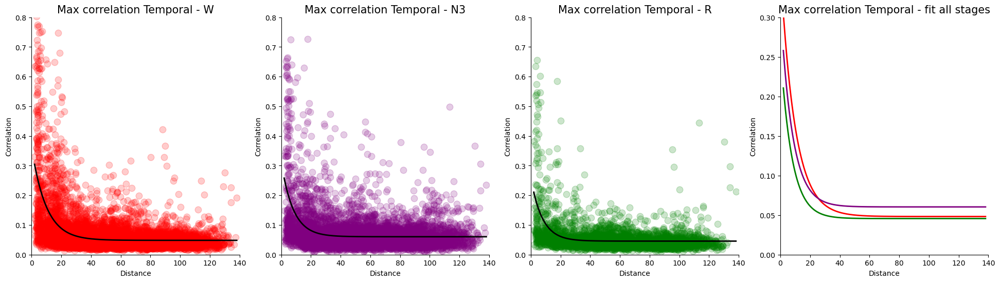

Occipital
W [14.85471067  0.2821408   0.03854398]
N3 [14.18043006  0.19423316  0.04692294]
R [13.30037584  0.1939068   0.040551  ]


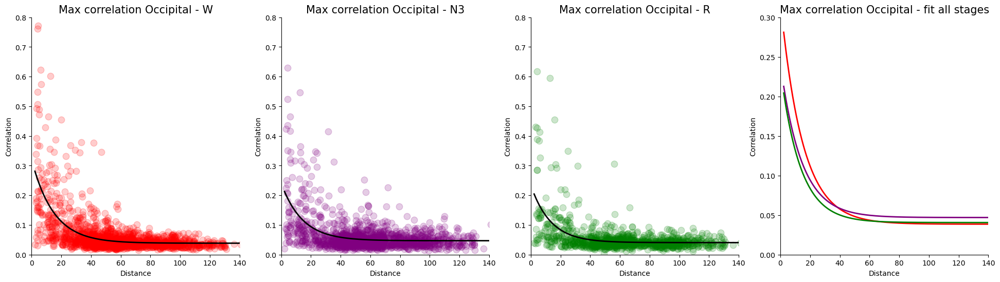

Insula
W [10.22885666  0.22120421  0.05266569]
N3 [12.09219358  0.16602202  0.06167141]
R [9.84861479 0.20631544 0.04474047]


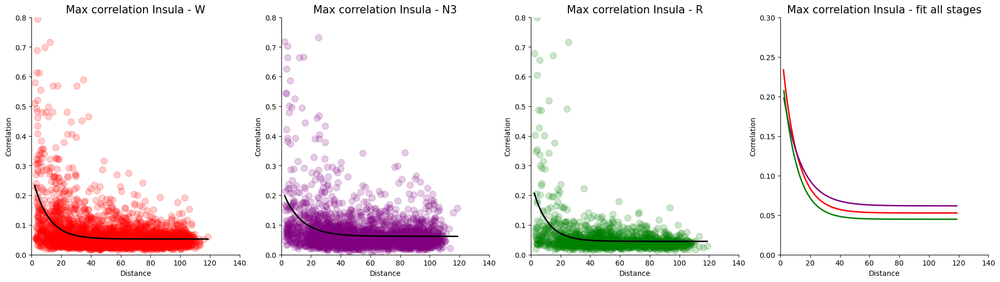

In [70]:
for lobe in df_sc_stage["lobe1"].unique():
    print(lobe)

    df_sc_lobe = df_sc_stages[stage]
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))

    for i, stage in enumerate(["W", "N3", "R"]):
        df_sc_stage_lobe = df_sc_stages[stage][
            (df_sc_stages[stage]["lobe1"] == lobe)
            | (df_sc_stages[stage]["lobe2"] == lobe)
        ]
        popt, pcov = curve_fit(
            uti._exp_decay,
            df_sc_stage_lobe["dist"],
            df_sc_stage_lobe["corr_max"],
            bounds=(([0, 0, -np.inf], [np.inf, np.inf, np.inf])),
        )
        print(stage, popt)

        # Plot of data
        axs[i].plot(
            df_sc_stage_lobe["dist"],
            df_sc_stage_lobe["corr_max"],
            "o",
            c=colors_stage[stage],
            ms=9,
            alpha=0.2,
        )
        axs[i].plot(
            df_sc_stage_lobe["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_lobe["dist"].sort_values(), *popt),
            "-",
            c="k",
            lw=2,
            zorder=9,
        )
        axs[i].set_ylim(0, 0.8)
        axs[i].set_xlim(0, 140)
        axs[i].set_xlabel("Distance", fontsize=10)
        axs[i].set_ylabel("Correlation", fontsize=10)
        axs[i].set_title(f"Max correlation {lobe} - {stage}", fontsize=15)
        axs[i].spines[["top", "right"]].set_visible(False)

        # Plot of fit
        axs[-1].plot(
            df_sc_stage_lobe["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_lobe["dist"].sort_values(), *popt),
            "-",
            c=colors_stage[stage],
            lw=2,
        )
        axs[-1].set_ylim(0, 0.3)
        axs[-1].set_xlim(0, 140)
        axs[-1].set_xlabel("Distance", fontsize=10)
        axs[-1].set_ylabel("Correlation", fontsize=10)
        axs[-1].set_title(f"Max correlation {lobe} - fit all stages", fontsize=15)
        axs[-1].spines[["top", "right"]].set_visible(False)
    plt.show()

Differences across lobes:
1. NREM3 higher correlation not strong for Occipital and Insula electrodes (but these are the lobes with also less electrodes); the effect is stronger for Frontal and Parietal electrodes.
2. The decay rate is also faster in NREM3 (compared to Wake) for Frontal, Parietal and Temporal electrodes and the opposite for Occipital/Insula.

### Plot one figure per brain region:

Middle temporal gyrus
W [9.64152066 0.31665282 0.05112955]
N3 [9.52885565 0.25847327 0.06402986]
R [8.60231419 0.26300863 0.04543035]


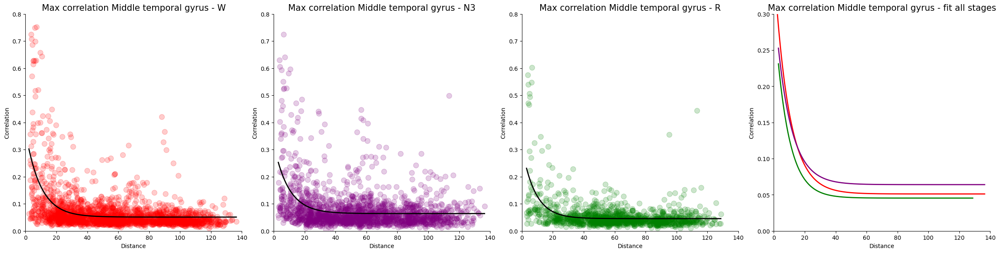

Medial frontal cortex
W [7.88792238 0.29551355 0.0494599 ]
N3 [9.21277214 0.26734204 0.06135835]
R [3.84628195 0.35798164 0.03783412]


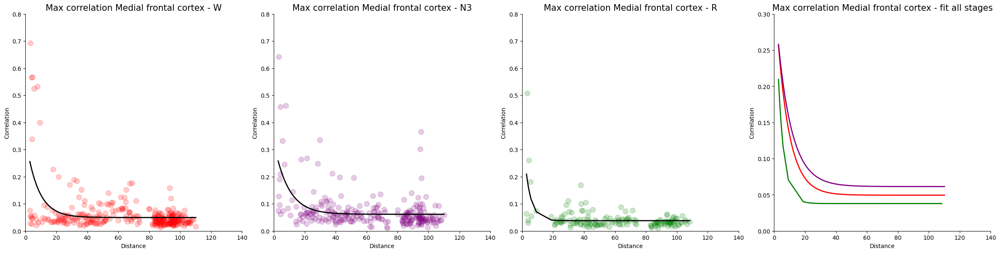

Planum temporale
W [9.34969502 0.35884273 0.04511245]
N3 [2.83063626 0.68330545 0.06211715]
R [1.93736217 1.         0.04781135]


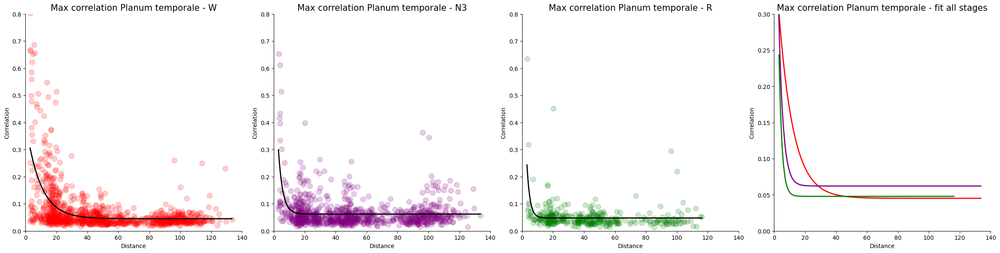

Middle cingulate
W [12.37317739  0.23033938  0.05154228]
N3 [11.42035343  0.17456872  0.06733727]
R [15.06522587  0.1458405   0.04731291]


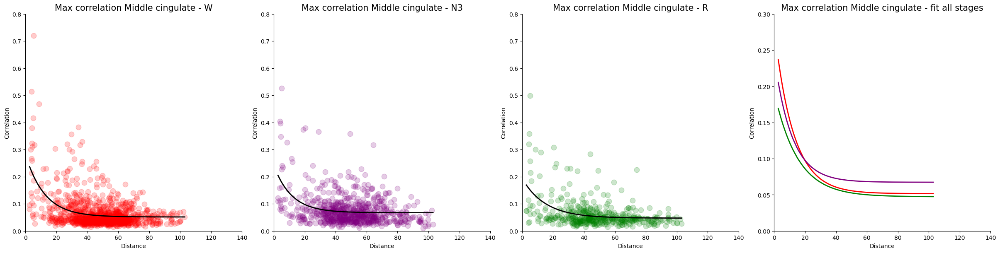

Precentral gyrus
W [11.04020405  0.32010586  0.04980074]
N3 [7.28587652 0.2733616  0.06537776]
R [5.46381798 0.37526182 0.05038129]


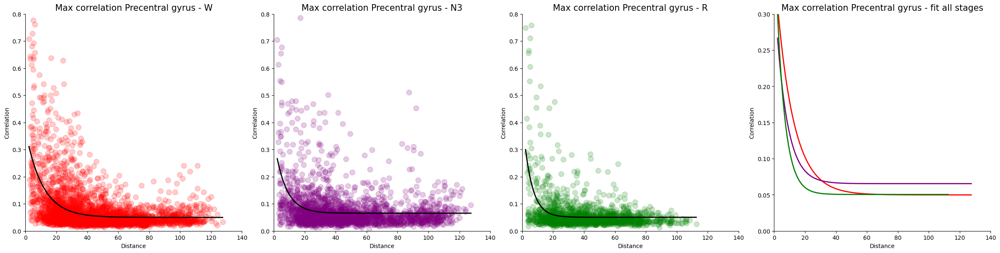

Supplementary motor cortex
W [10.30458808  0.30923097  0.05671244]
N3 [6.027416   0.39509968 0.07105636]
R [4.4241522  0.5085004  0.05865777]


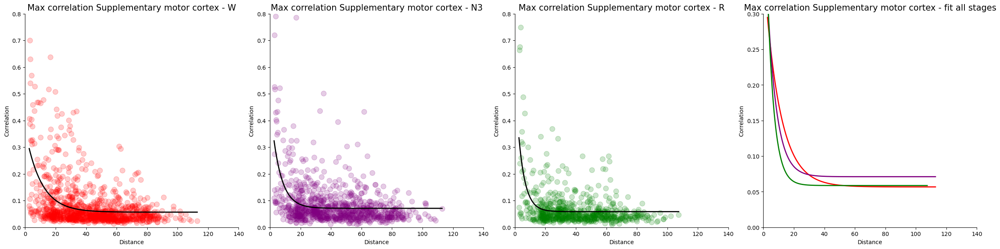

Anterior insula
W [9.96187096 0.24624966 0.05315863]
N3 [13.20976816  0.16280501  0.06061224]
R [10.72195433  0.18743793  0.04343789]


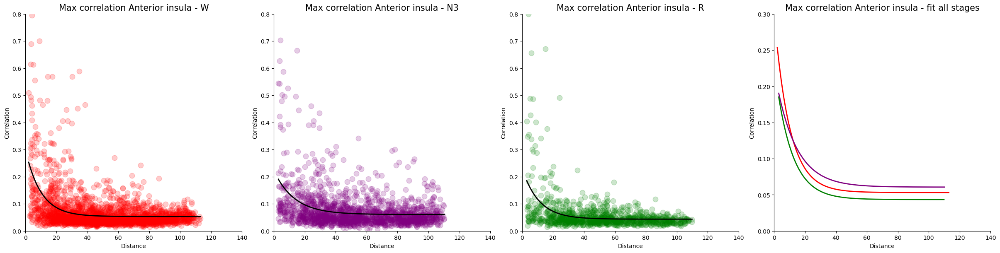

Temporal pole and planum polare
W [8.55331724 0.28725896 0.04425163]
N3 [16.30170107  0.09956055  0.05404516]
R [13.45683562  0.04408033  0.0466269 ]


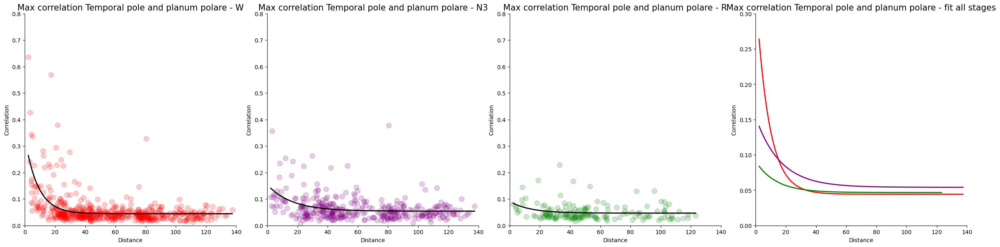

Hippocampus
W [15.11294867  0.21065234  0.04744823]
N3 [9.99739769 0.3012926  0.05149592]
R [19.98733953  0.11989584  0.03878013]


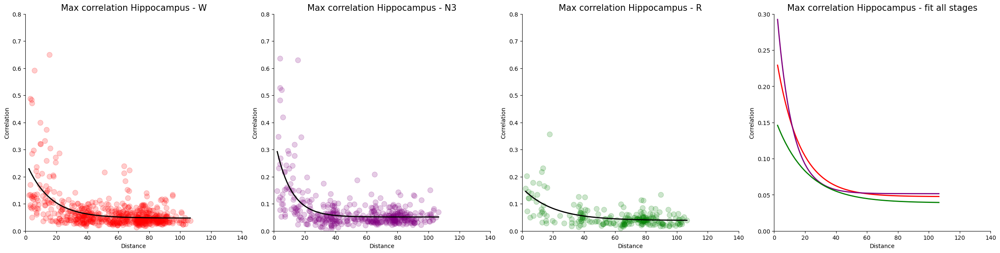

Central operculum
W [6.7815466  0.45239707 0.06740311]
N3 [4.36805452 0.61744287 0.07168327]
R [4.88441236 0.48693183 0.05385111]


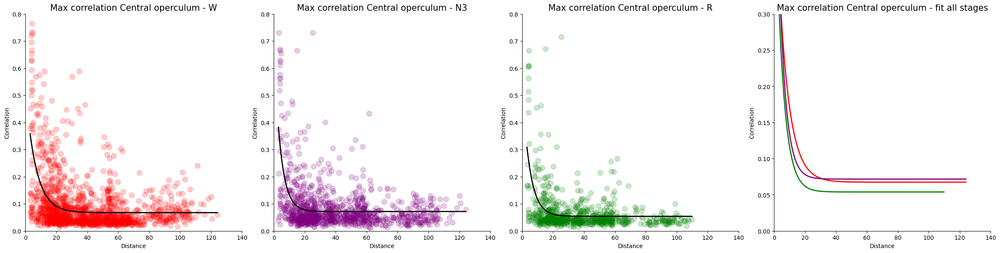

Transverse temporal gyrus
W [18.42618587  0.13793622  0.03980112]
N3 [14.14095718  0.10591103  0.05161594]
R [7.61714464e+01 8.01440314e-02 9.04166540e-03]


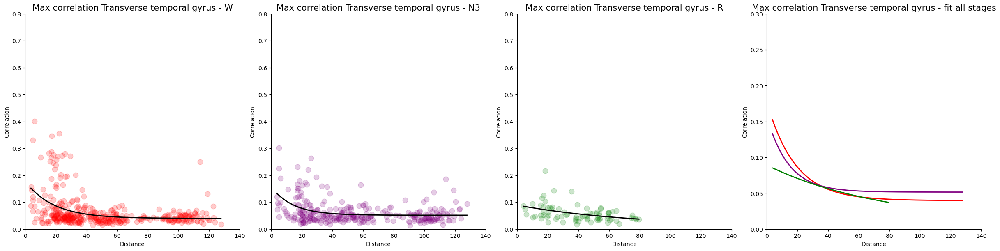

Lingual gyrus and occipital fusiform gyrus
W [15.84257937  0.27651072  0.03499941]
N3 [18.05233685  0.15899077  0.03950318]
R [13.43447644  0.17103456  0.04063758]


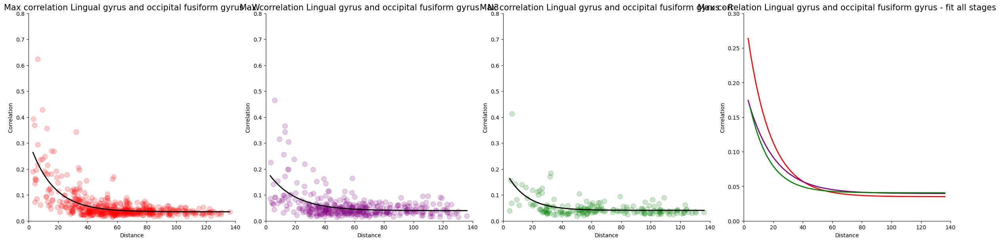

Fusiform and parahippocampal gyri
W [7.93767501 0.34064879 0.05146683]
N3 [7.10181013 0.21020486 0.05839175]
R [6.60068531 0.17856149 0.04888881]


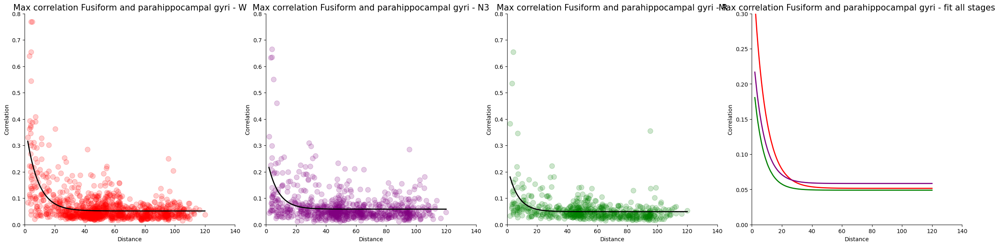

Inferior temporal gyrus
W [5.18918142 0.52105903 0.05317572]
N3 [3.6811881  0.58216509 0.06786012]
R [5.13455037 0.37277224 0.05315042]


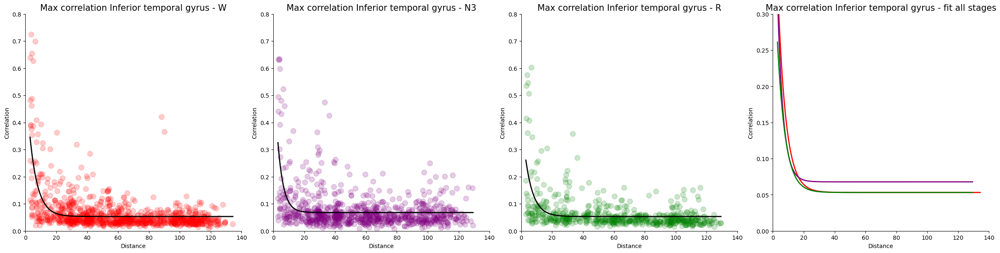

Postcentral gyrus (including medial segment)
W [11.84103129  0.28180435  0.04091834]
N3 [10.41453383  0.20840097  0.05756638]
R [7.39233776 0.26122073 0.05192408]


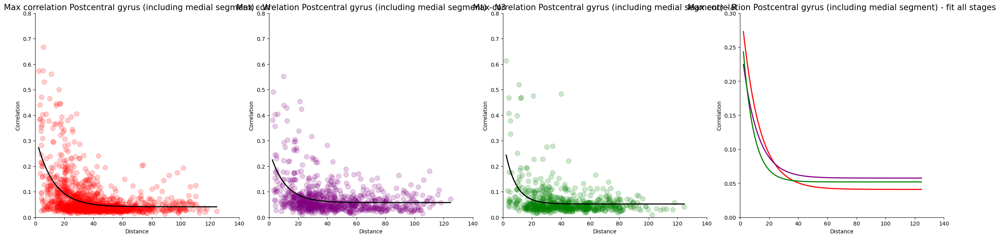

Precuneus
W [10.05727304  0.20872339  0.04569937]
N3 [8.55216895 0.21688368 0.06400124]
R [7.9151631  0.25430223 0.04359665]


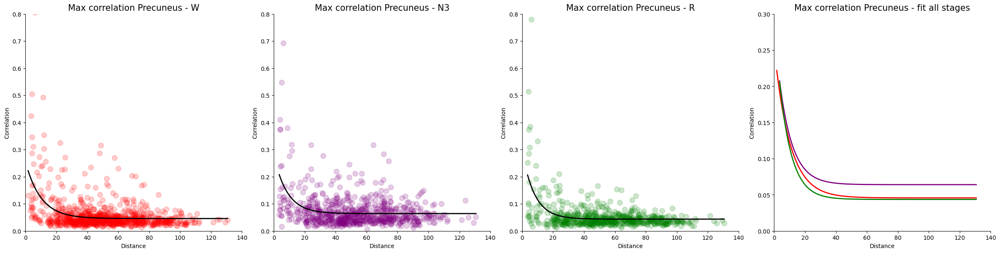

Angular gyrus
W [3.45400979 0.42592459 0.0497924 ]
N3 [2.01756486 1.         0.07211792]
R [2.08575826 0.80170007 0.05014344]


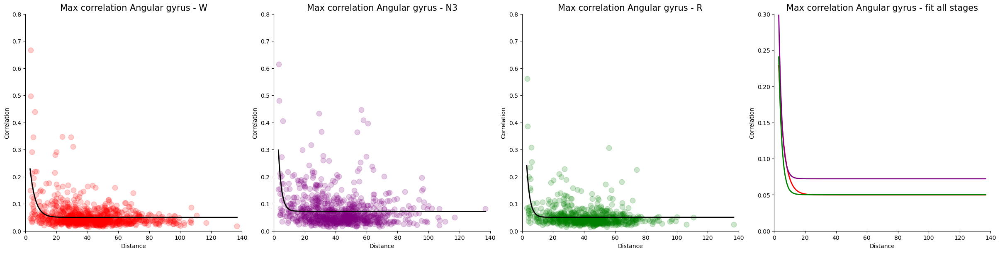

Opercular part of inferior frontal gyrus
W [8.31198149 0.28077601 0.04734198]
N3 [9.43306368 0.21345993 0.06399883]
R [10.41944217  0.18028661  0.04761874]


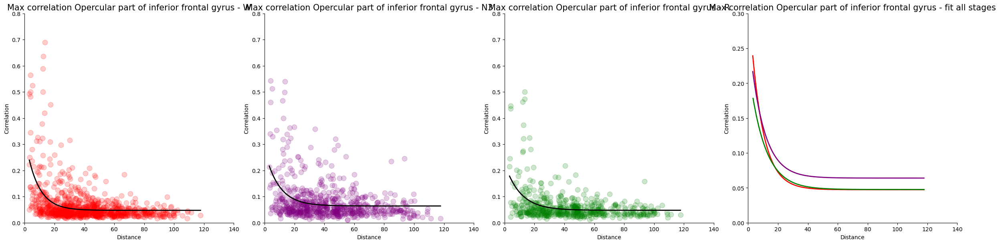

Parietal operculum
W [7.50366264 0.58834781 0.05199665]
N3 [4.46650926 0.47454413 0.05872355]
R [3.6095798  0.26324893 0.04092087]


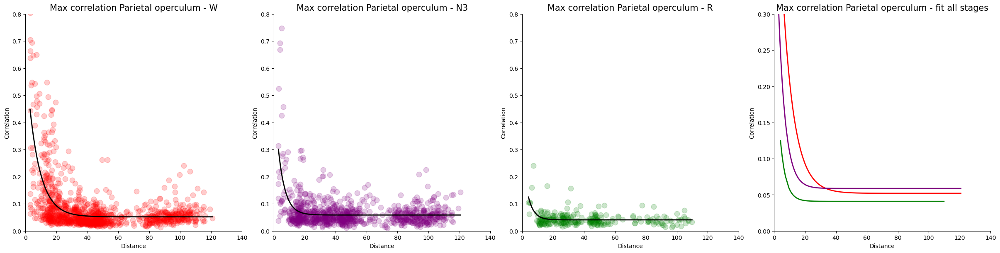

Frontal operculum
W [8.85586255 0.33112977 0.04291406]
N3 [5.80824446 0.36824169 0.06711852]
R [7.46803563 0.39398008 0.04351334]


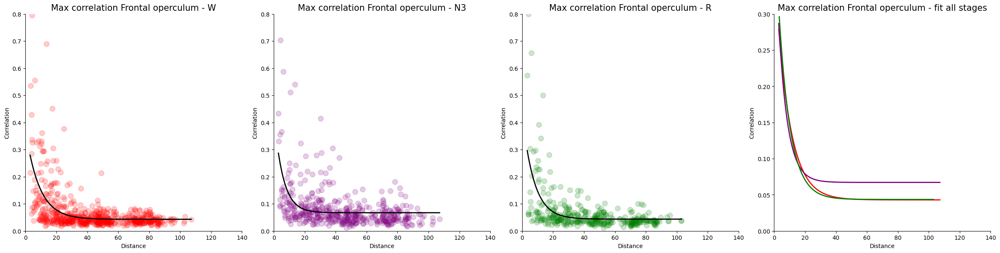

Triangular part of inferior frontal gyrus
W [11.75909101  0.29212356  0.04282973]
N3 [12.26025418  0.21616196  0.06159997]
R [12.89112285  0.23658037  0.04126272]


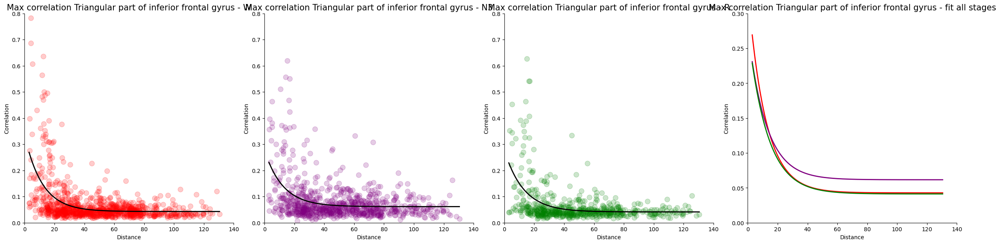

Middle frontal gyrus
W [14.31315604  0.16657301  0.04425044]
N3 [11.95251368  0.17085292  0.0673504 ]
R [11.66916103  0.14929199  0.04433484]


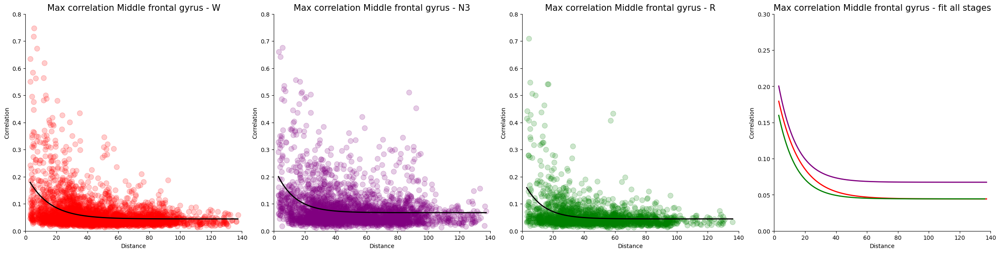

Anterior cingulate
W [10.46696832  0.35461699  0.056529  ]
N3 [14.45526905  0.23530468  0.0621808 ]
R [14.97046196  0.21827462  0.03917522]


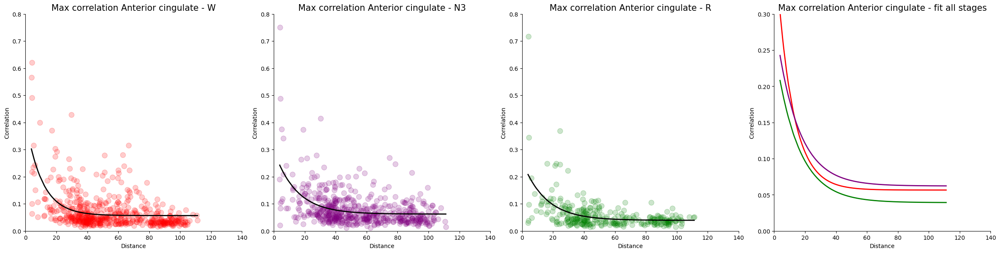

Superior temporal gyrus
W [10.16440393  0.36506173  0.0456719 ]
N3 [7.22231245 0.31825082 0.06105781]
R [7.07679404 0.23469489 0.04519473]


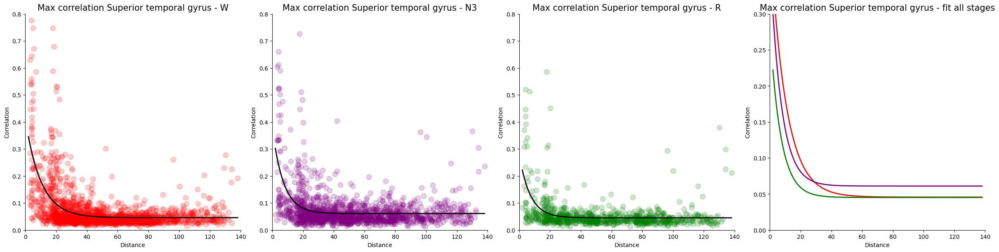

Posterior insula
W [12.05987142  0.16573251  0.05147813]
N3 [10.58497053  0.20412366  0.06233002]
R [9.14556375 0.31751608 0.04568139]


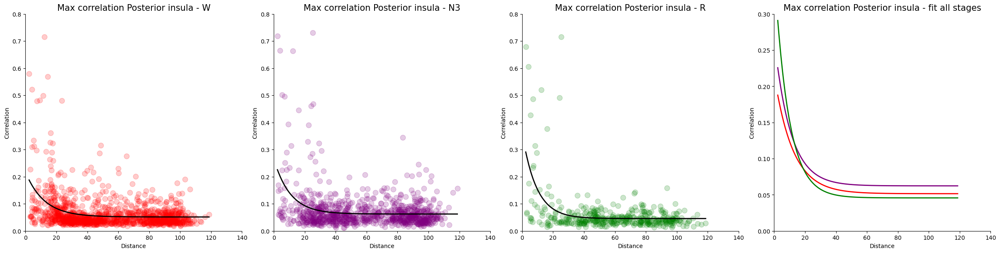

Medial segment of precentral gyrus
W [11.20824003  0.64485981  0.03590563]
N3 [6.00075803 0.72886116 0.06151907]
R [5.98677944 0.73716211 0.04609255]


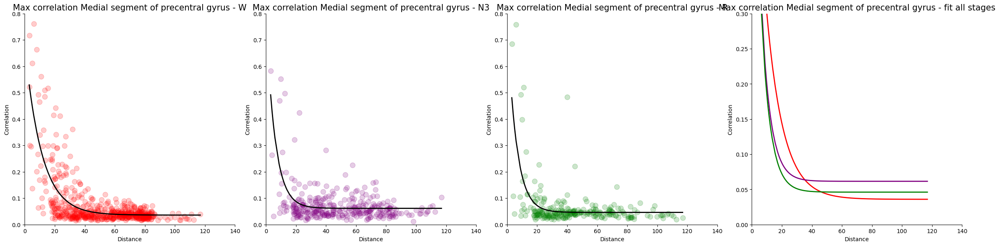

Medial segment of superior frontal gyrus
W [20.16888912  0.09105858  0.04456051]
N3 [17.76799196  0.09031795  0.06572985]
R [5.18290104e+01 1.01526357e-01 2.38812689e-02]


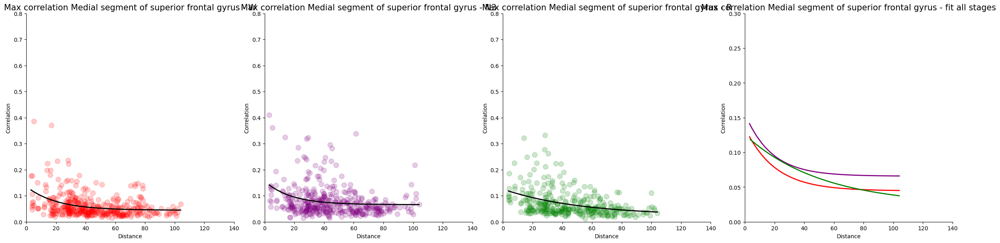

Superior frontal gyrus and frontal pole
W [10.80093357  0.26666817  0.05572231]
N3 [7.10576968 0.28761293 0.07594067]
R [10.30343386  0.15049834  0.05073755]


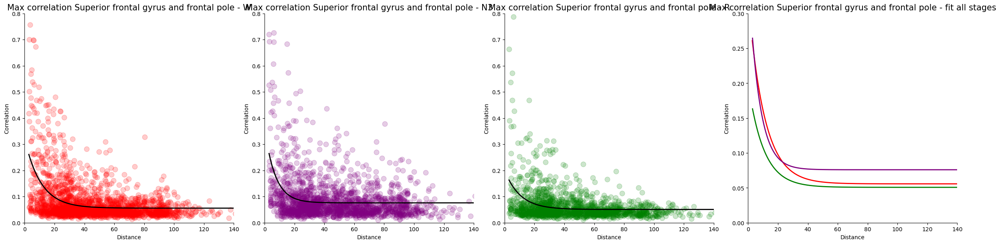

Superior parietal lobule
W [6.33148904 0.30429757 0.05757506]
N3 [11.30693259  0.12088442  0.0646659 ]
R [7.2622774  0.11329805 0.0522982 ]


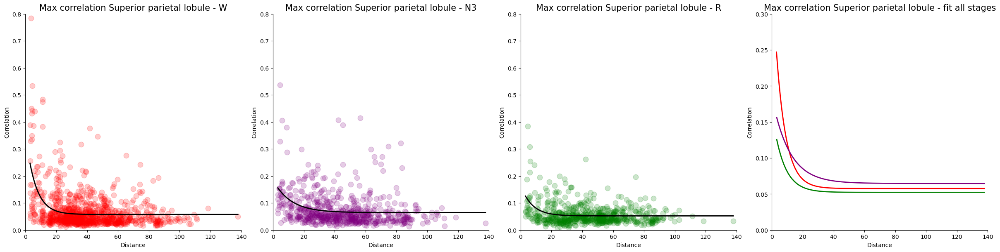

Posterior cingulate
W [11.07375795  0.2474611   0.03801994]
N3 [2.9848778  1.         0.05870137]
R [3.12251862 1.         0.04881297]


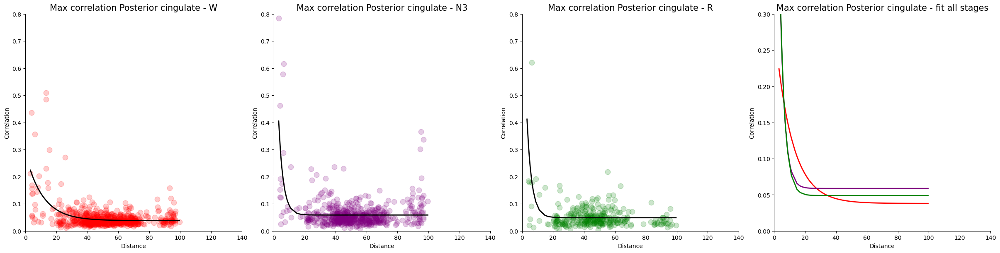

Supramarginal gyrus
W [6.37856319 0.31296472 0.04572918]
N3 [5.29986659 0.33879361 0.06388685]
R [5.38328521 0.32695849 0.04790658]


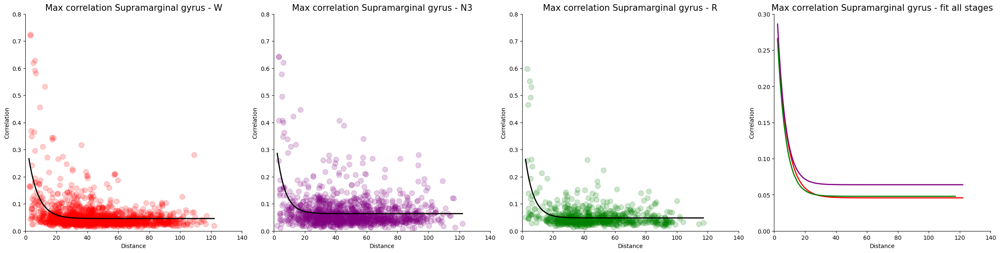

Gyrus rectus and orbital gyri
W [6.19129833 0.26619174 0.04634517]
N3 [5.11240446 0.31391376 0.06682922]
R [4.21841741 0.29915617 0.04930164]


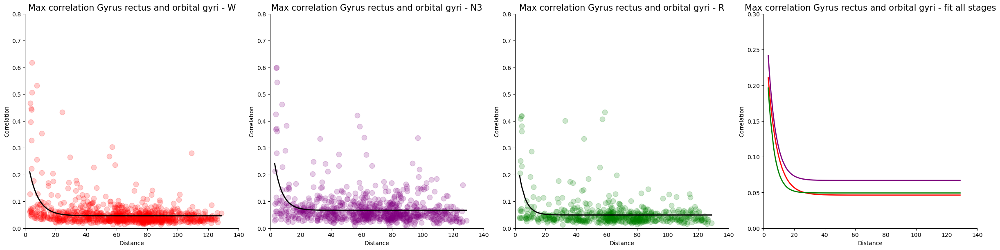

Amygdala
W [8.24943156 0.30810032 0.08573423]
N3 [20.64870109  0.14674433  0.04806507]
R [7.70813061 0.28771336 0.03841727]


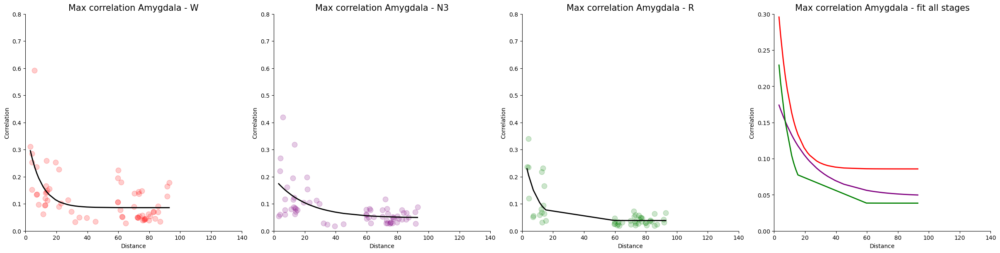

Inferior ocipital gyrus and occipital pole
W [13.56513062  0.35050899  0.04213061]
N3 [13.10784739  0.25564677  0.04999675]
R [14.96670988  0.25987276  0.04314373]


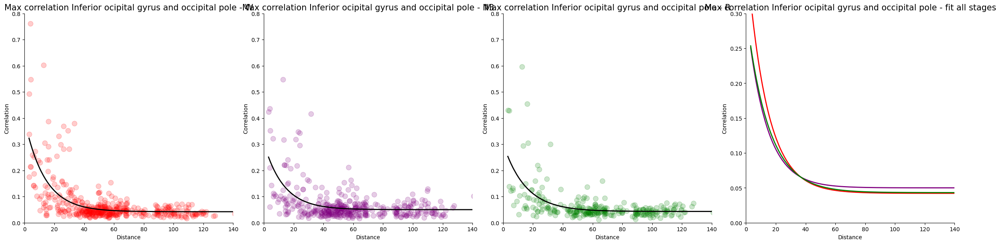

Calcarine cortex
W [24.71859602  0.18810001  0.03309197]
N3 [17.55183597  0.25402607  0.03778534]
R [17.49552738  0.21487756  0.03786828]


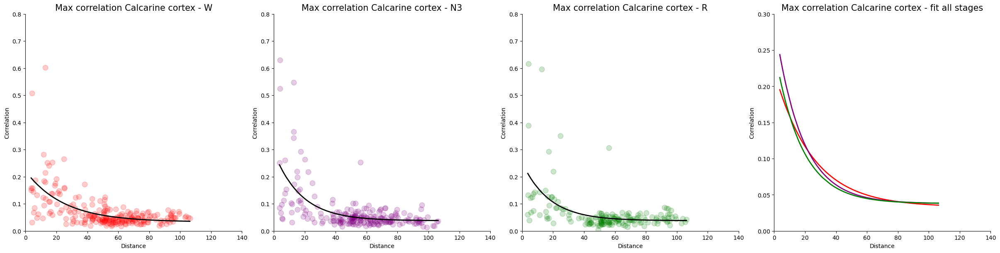

Superior and middle occipital gyri
W [24.37892696  0.19223722  0.03010997]
N3 [16.02751709  0.18900949  0.05143219]
R [14.88135921  0.21916386  0.03577996]


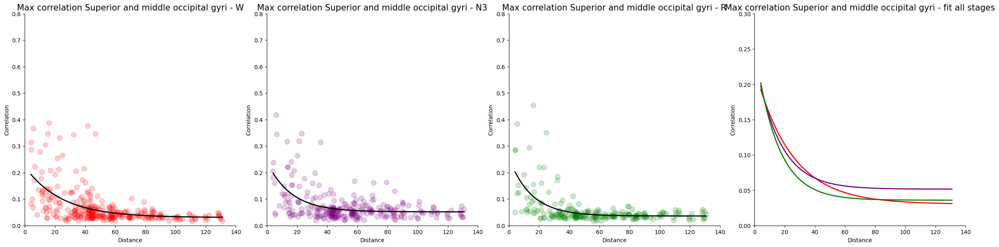

Cuneus
W [15.66305516  0.31970145  0.03465053]
N3 [23.54418079  0.08333794  0.04495677]
R [23.93952362  0.09459995  0.03310836]


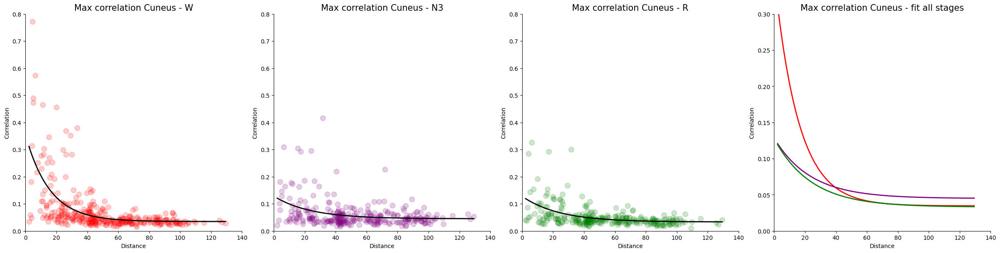

Orbital part of inferior frontal gyrus
W [5.23880355 0.65741964 0.05389429]
N3 [4.76343285 0.51435569 0.07815272]
R [5.05693605 0.59136439 0.04781473]


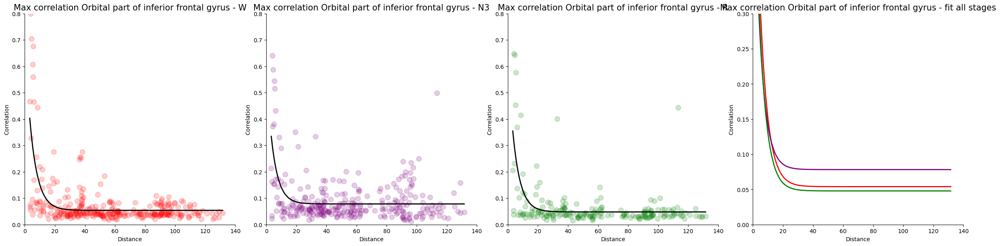

In [8]:
N = 20  # minimum number of points to fit
# Dataframe for storing parameters results
Regions = df_sc_stages["W"]["region1"].unique()
df_sc_params = pd.DataFrame(
    columns=["region", "stage", "k", "a", "b"], index=range(len(Regions) * 3)
)
idx_df = 0

for region in Regions:
    print(region)

    fig, axs = plt.subplots(1, 4, figsize=(24, 6), layout="constrained")

    for i, stage in enumerate(["W", "N3", "R"]):
        df_sc_stage_region = df_sc_stages[stage][
            (df_sc_stages[stage]["region1"] == region)
            | (df_sc_stages[stage]["region2"] == region)
        ]
        if len(df_sc_stage_region) < N:
            print(f"Skipping {region} - {stage}")
            df_sc_params.loc[idx_df, "region"] = region
            df_sc_params.loc[idx_df, "stage"] = stage
            df_sc_params.loc[idx_df, "k"] = np.nan
            df_sc_params.loc[idx_df, "a"] = np.nan
            df_sc_params.loc[idx_df, "b"] = np.nan
            idx_df += 1
            continue
        popt, pcov = curve_fit(
            uti._exp_decay,
            df_sc_stage_region["dist"],
            df_sc_stage_region["corr_max"],
            bounds=(([0, 0, -1], [100, 1, 1])),
        )
        print(stage, popt)
        # Update dataframe
        df_sc_params.loc[idx_df, "region"] = region
        df_sc_params.loc[idx_df, "stage"] = stage
        df_sc_params.loc[idx_df, "k"] = popt[0]
        df_sc_params.loc[idx_df, "a"] = popt[1]
        df_sc_params.loc[idx_df, "b"] = popt[2]
        idx_df += 1

        # Plot of data
        axs[i].plot(
            df_sc_stage_region["dist"],
            df_sc_stage_region["corr_max"],
            "o",
            c=colors_stage[stage],
            ms=9,
            alpha=0.2,
        )
        axs[i].plot(
            df_sc_stage_region["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_region["dist"].sort_values(), *popt),
            "-",
            c="k",
            lw=2,
            zorder=9,
        )
        axs[i].set_ylim(0, 0.8)
        axs[i].set_xlim(0, 140)
        axs[i].set_xlabel("Distance", fontsize=10)
        axs[i].set_ylabel("Correlation", fontsize=10)
        axs[i].set_title(f"Max correlation {region} - {stage}", fontsize=15)
        axs[i].spines[["top", "right"]].set_visible(False)

        # Plot of fit
        axs[-1].plot(
            df_sc_stage_region["dist"].sort_values(),
            uti._exp_decay(df_sc_stage_region["dist"].sort_values(), *popt),
            "-",
            c=colors_stage[stage],
            lw=2,
        )
        axs[-1].set_ylim(0, 0.3)
        axs[-1].set_xlim(0, 140)
        axs[-1].set_xlabel("Distance", fontsize=10)
        axs[-1].set_ylabel("Correlation", fontsize=10)
        axs[-1].set_title(f"Max correlation {region} - fit all stages", fontsize=15)
        axs[-1].spines[["top", "right"]].set_visible(False)
    plt.show()

In [12]:
df_sc_params.to_csv(res_path.joinpath(f"SC_fit_params.csv"))
df_sc_params

,region,stage,k,a,b
0,Middle temporal gyrus,W,9.641521,0.316653,0.05113
1,Middle temporal gyrus,N3,9.528856,0.258473,0.06403
2,Middle temporal gyrus,R,8.602314,0.263009,0.04543
3,Medial frontal cortex,W,7.887922,0.295514,0.04946
4,Medial frontal cortex,N3,9.212772,0.267342,0.061358
...,...,...,...,...,...
109,Cuneus,N3,23.544181,0.083338,0.044957
110,Cuneus,R,23.939524,0.0946,0.033108
111,Orbital part of inferior frontal gyrus,W,5.238804,0.65742,0.053894
112,Orbital part of inferior frontal gyrus,N3,4.763433,0.514356,0.078153


Load if already computed:

In [7]:
df_sc_params = pd.read_csv(res_path.joinpath(f"SC_fit_params.csv"), index_col=0)

Plot:

In [8]:
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)

C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(
C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(


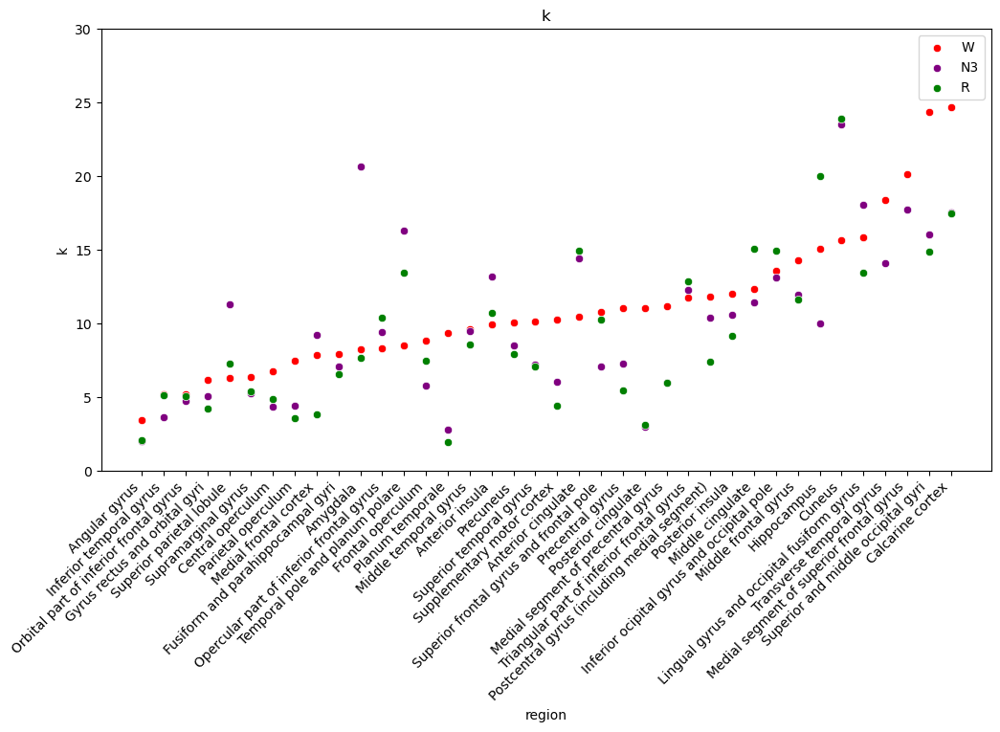

C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(
C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(


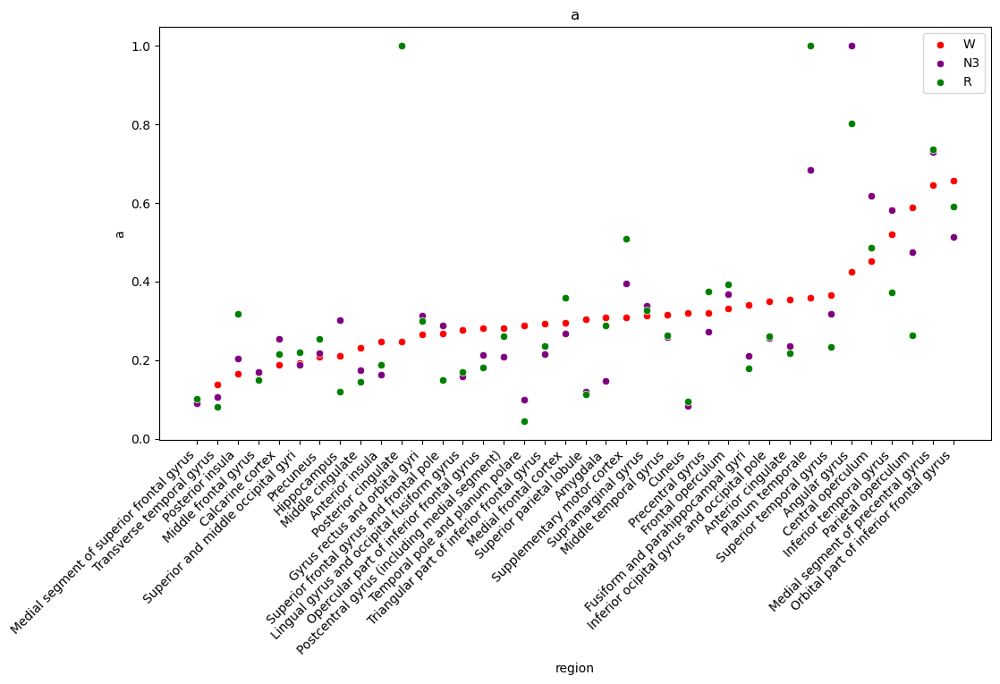

C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(
C:\Users\ricca\AppData\Local\Temp\ipykernel_27544\1356122930.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sc_param_stage.sort_values(


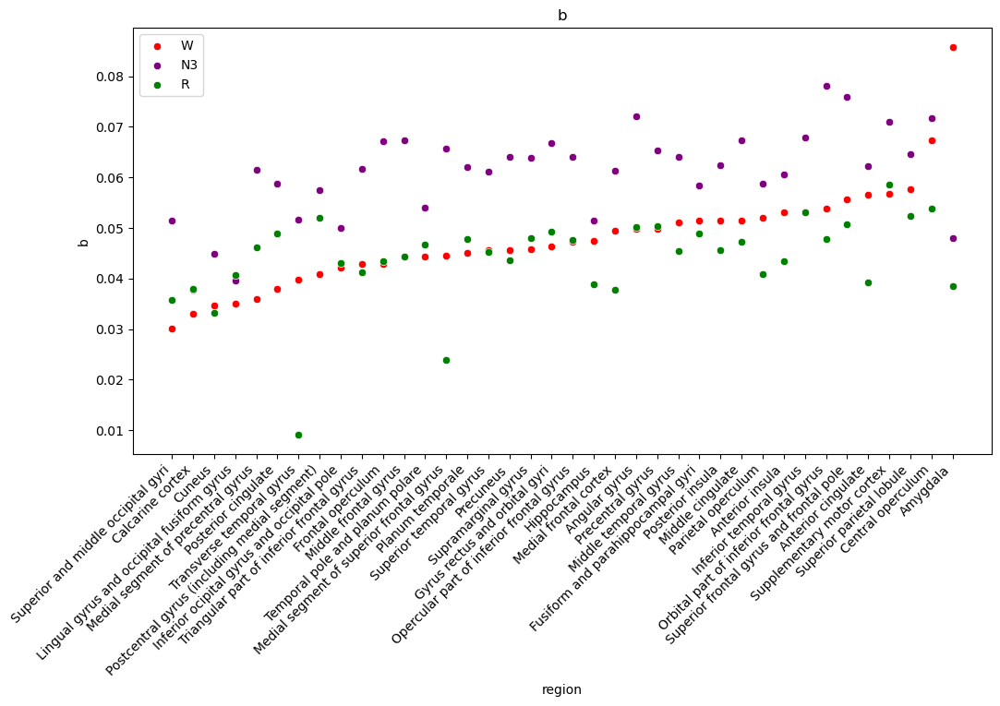

In [84]:
for param in ["k", "a", "b"]:
    fig, ax = plt.subplots(figsize=(12, 6))
    for stage in ["W", "N3", "R"]:
        df_sc_param_stage = df_sc_params[df_sc_params["stage"] == stage]
        # Set order from wake
        if stage == "W":
            df_sc_param_stage = df_sc_param_stage.sort_values(param)
            regions_order = df_sc_param_stage["region"].tolist()
        else:
            df_sc_param_stage.sort_values(
                by="region",
                key=lambda column: column.map(lambda e: regions_order.index(e)),
                inplace=True,
            )
        sns.scatterplot(
            x="region",
            y=param,
            data=df_sc_param_stage,
            c=colors_stage[stage],
            ax=ax,
            label=stage,
        )
    plt.xticks(rotation=45, ha="right")
    ax.set_ylabel("Value", fontsize=10)
    ax.set_title("Parameter " + param, fontsize=15)
    if param == "k":
        ax.set_ylim(0, 30)
    plt.show()

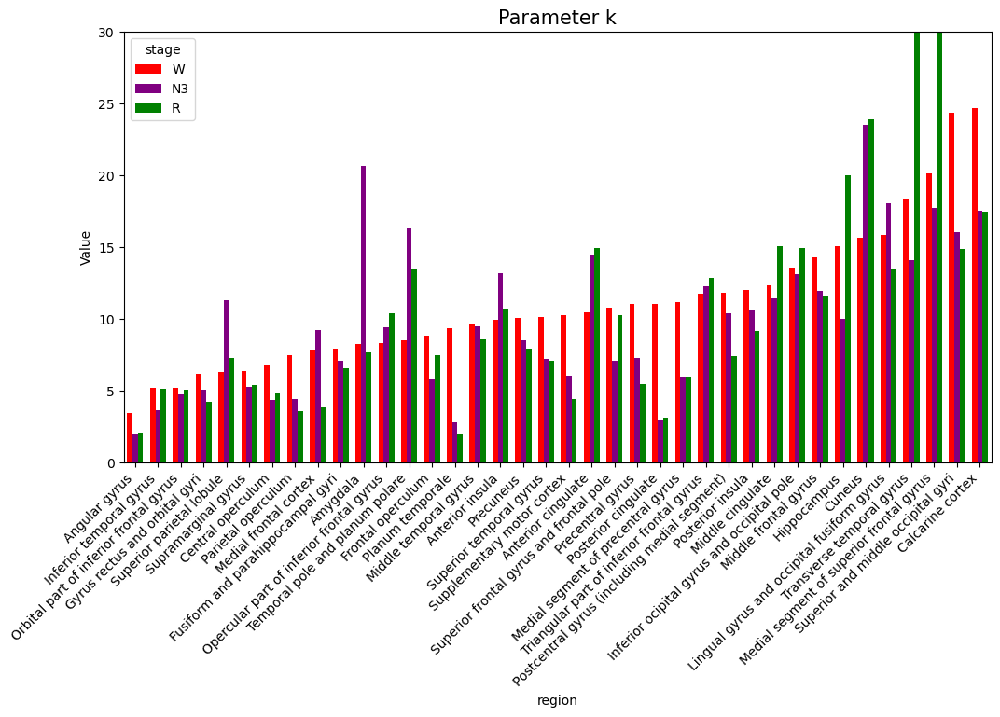

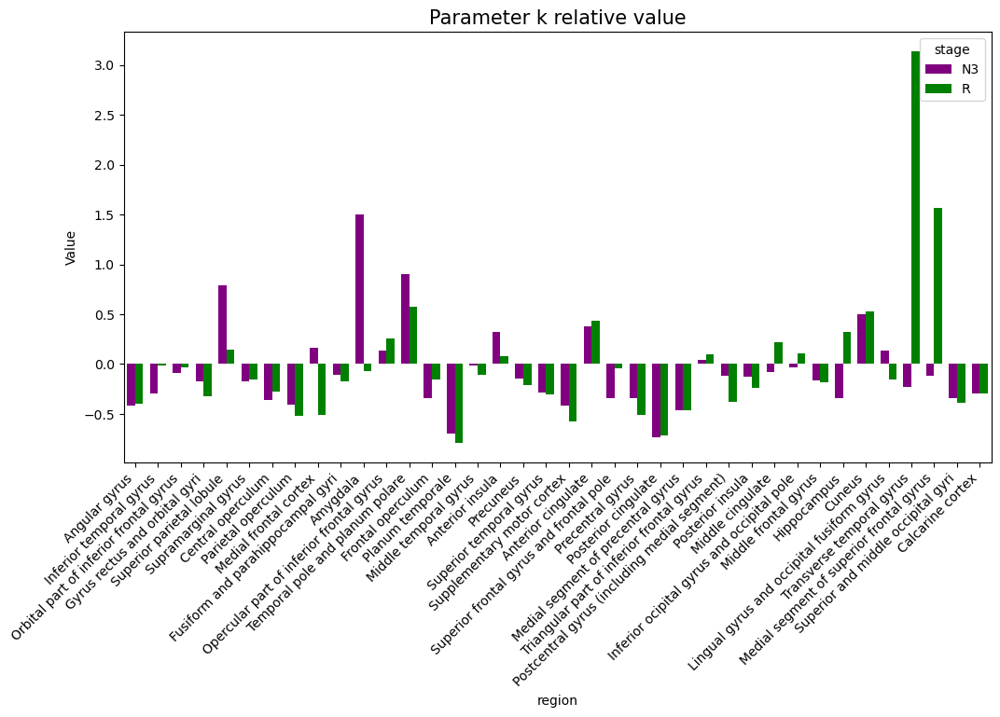

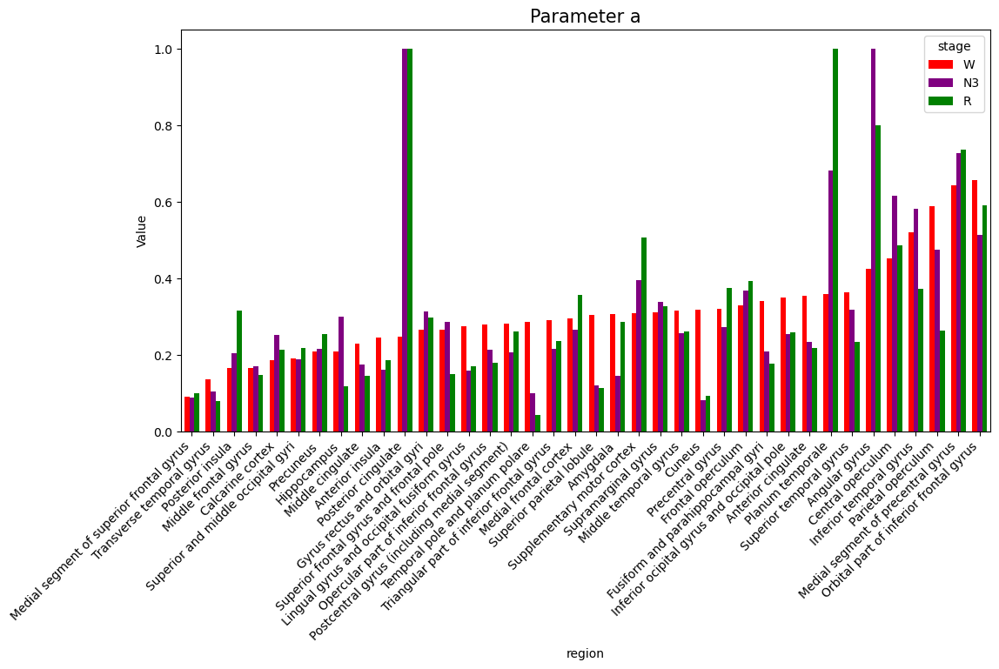

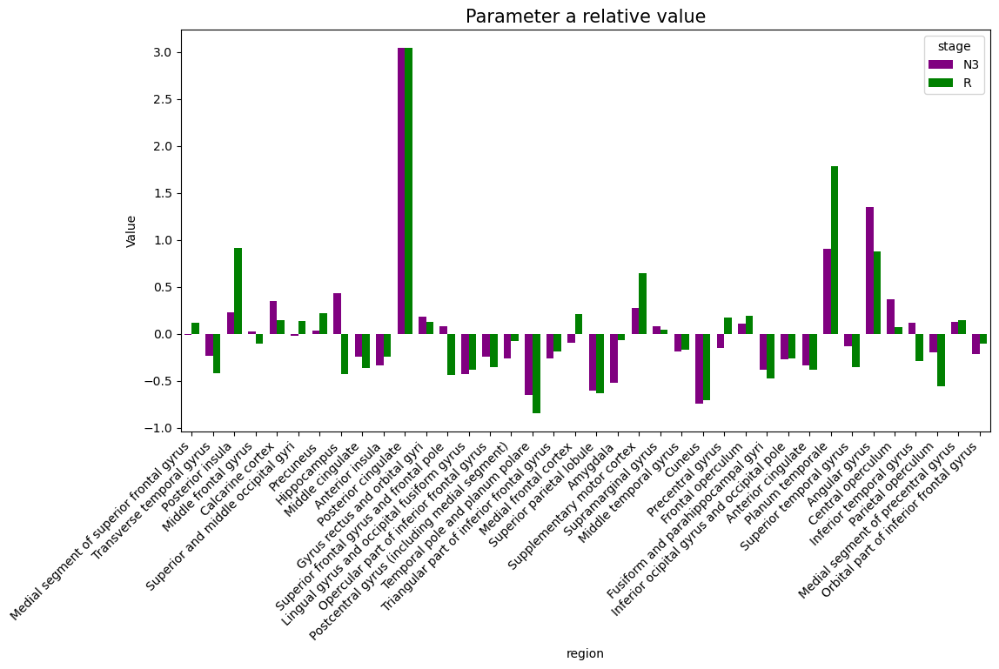

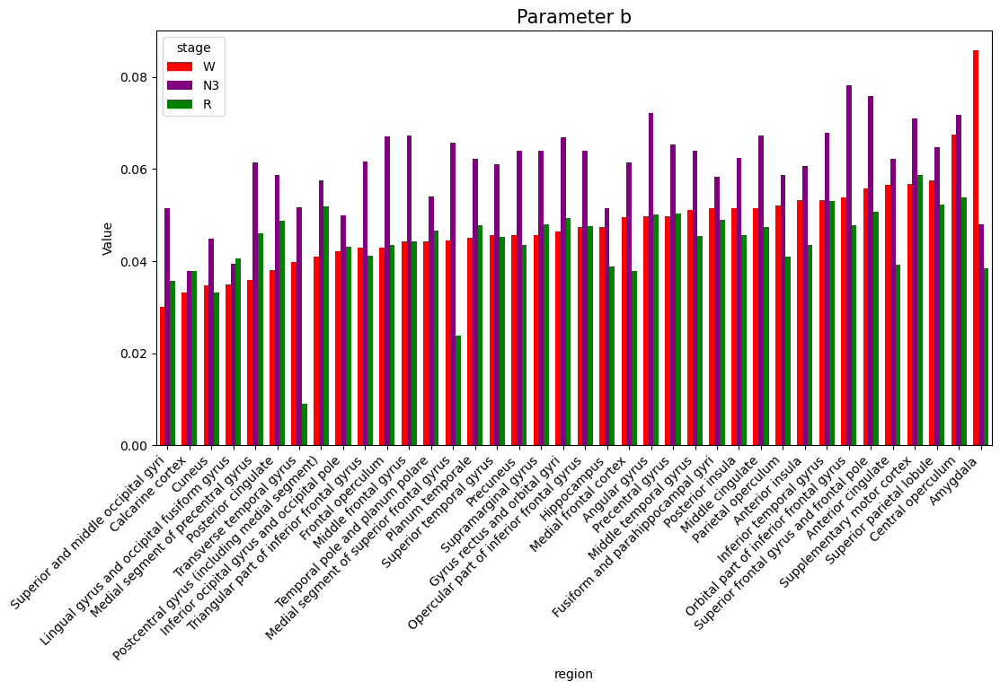

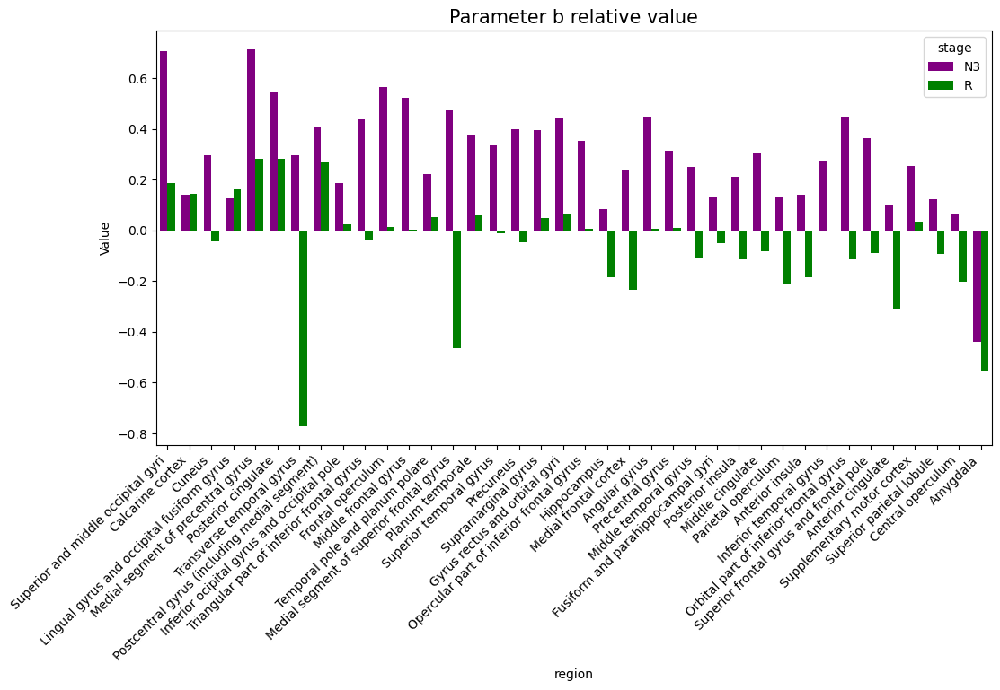

In [26]:
for param in ["k", "a", "b"]:
    # Figure with absolute values
    fig, ax = plt.subplots(figsize=(12, 6))
    regions_order = (
        df_sc_params[df_sc_params["stage"] == "W"].sort_values(param)["region"].tolist()
    )
    sns.barplot(
        x="region",
        y=param,
        data=df_sc_params,
        hue="stage",
        order=regions_order,
        hue_order=["W", "N3", "R"],
        errorbar=None,
        width=0.7,
        dodge=True,
        palette=colors_stage,
        saturation=1,
        ax=ax,
    )
    plt.xticks(rotation=45, ha="right")
    ax.set_ylabel("Value", fontsize=10)
    ax.set_title("Parameter " + param, fontsize=15)
    if param == "k":
        ax.set_ylim(0, 30)

    # Figure with relative values (to Wake)
    fig, ax = plt.subplots(figsize=(12, 6))
    df_plot_rel = pd.DataFrame(
        columns=["region", "stage", param], index=df_sc_params.index
    )
    for region in df_sc_params["region"].unique():
        df_plot_rel.loc[df_sc_params["region"] == region, "region"] = region
        df_plot_rel.loc[df_sc_params["region"] == region, "stage"] = df_sc_params.loc[
            df_sc_params["region"] == region, "stage"
        ]
        df_plot_rel.loc[df_sc_params["region"] == region, param] = (
            df_sc_params.loc[df_sc_params["region"] == region, param]
            / df_sc_params.loc[df_sc_params["region"] == region, param].iloc[0]
        ) - 1
    df_plot_rel.drop(index=df_plot_rel[df_plot_rel["stage"] == "W"].index, inplace=True)
    sns.barplot(
        x="region",
        y=param,
        data=df_plot_rel,
        hue="stage",
        order=regions_order,
        hue_order=["N3", "R"],
        errorbar=None,
        width=0.7,
        dodge=True,
        palette=colors_stage,
        saturation=1,
        ax=ax,
    )
    plt.xticks(rotation=45, ha="right")
    ax.set_ylabel("Value", fontsize=10)
    ax.set_title(f"Parameter {param} relative value", fontsize=15)

    plt.show()

### Correlation with timescales

In [21]:
df_tau = pd.read_csv(base_path.joinpath("Results/all_tau.csv"), index_col=0)

In [9]:
df_tau[["region", "tau"]].groupby("region").mean()

,tau
region,
Amygdala,67.043589
Angular gyrus,61.505939
Anterior cingulate,52.210945
Anterior insula,50.928875
Calcarine cortex,46.500757
Central operculum,46.653989
Cuneus,41.431644
Frontal operculum,52.968982
Fusiform and parahippocampal gyri,48.266086


In [10]:
import statsmodels.formula.api as smf
data = df_tau.copy()
md = smf.mixedlm("tau ~ 0 + region", data, groups=data["pat"])
mdf = md.fit()
df_tau_stage = mdf.fe_params
df_tau_stage.index = df_tau_stage.index.str.strip("region[").str.strip("]")

IndexError: index 5720 is out of bounds for axis 0 with size 5720

In [45]:
df_tau_stage

Amygdala                                        45.251436
Angular gyrus                                   29.510606
Anterior cingulate                              39.078081
Anterior insula                                 31.651329
Calcarine cortex                                20.040284
Central operculum                               26.286322
Cuneus                                          17.044389
Frontal operculum                               28.226073
Fusiform and parahippocampal gyri               26.983376
Gyrus rectus and orbital gyri                   33.705675
Hippocampus                                     54.927215
Inferior ocipital gyrus and occipital pole      28.602458
Inferior temporal gyrus                         26.133999
Lingual gyrus and occipital fusiform gyrus      23.624658
Medial frontal cortex                           36.665529
Medial segment of precentral gyrus              11.906409
Medial segment of superior frontal gyrus        34.357767
Middle cingula

In [11]:
df_spa = df_sc_params[df_sc_params["stage"] == "W"].set_index("region")["k"].astype(float)
df_temp = df_tau[["region", "tau"]].groupby("region").mean()

In [12]:
df_spa.loc[df_temp.index]

region
Amygdala                                         8.249432
Angular gyrus                                    3.454010
Anterior cingulate                              10.466968
Anterior insula                                  9.961871
Calcarine cortex                                24.718596
Central operculum                                6.781547
Cuneus                                          15.663055
Frontal operculum                                8.855863
Fusiform and parahippocampal gyri                7.937675
Gyrus rectus and orbital gyri                    6.191298
Hippocampus                                     15.112949
Inferior ocipital gyrus and occipital pole      13.565131
Inferior temporal gyrus                          5.189181
Lingual gyrus and occipital fusiform gyrus      15.842579
Medial frontal cortex                            7.887922
Medial segment of precentral gyrus              11.208240
Medial segment of superior frontal gyrus        20.168889
Middle 

W k
Linregress LinregressResult(slope=-0.0915832659279306, intercept=28.98315532085288, rvalue=-0.05801388992935764, pvalue=0.7293676326630731, stderr=0.26266416342469107, intercept_stderr=3.1687871825987366)
Spearman SignificanceResult(statistic=-0.14410767042345987, pvalue=0.3880371031999874)
W a
Linregress LinregressResult(slope=-16.946018313641538, intercept=33.281056222826436, rvalue=-0.28035361498051625, pvalue=0.08821973474316101, stderr=9.670185402087505, intercept_stderr=3.2619201917169796)
Spearman SignificanceResult(statistic=-0.11281321807637597, pvalue=0.5000860849880437)
W b
Linregress LinregressResult(slope=332.60301621385486, intercept=12.05260914281035, rvalue=0.43428969767062725, pvalue=0.0064424881912868185, stderr=114.9769779002682, intercept_stderr=5.616519993864905)
Spearman SignificanceResult(statistic=0.3143669985775249, pvalue=0.054580301876655614)


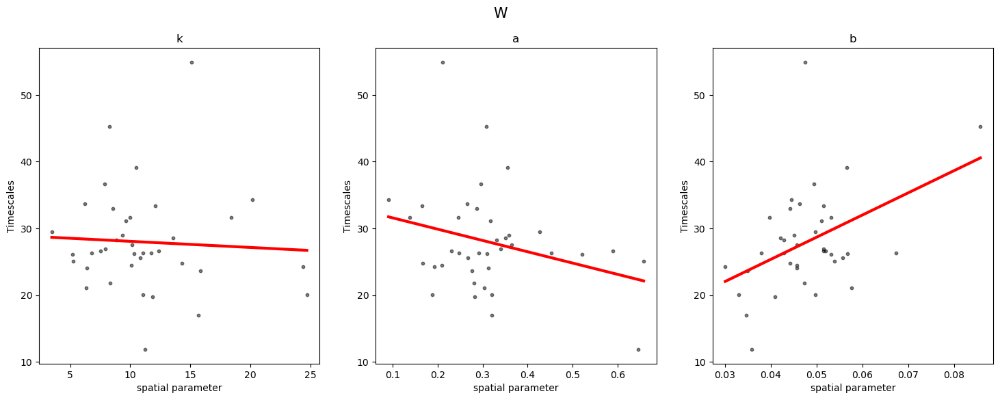

N3 k
Linregress LinregressResult(slope=-0.6194937716972386, intercept=90.89579623888538, rvalue=-0.3744520608572457, pvalue=0.020550165213533464, stderr=0.25567282264358937, intercept_stderr=2.8975537129309514)
Spearman SignificanceResult(statistic=-0.28526096947149576, pvalue=0.08256378243998176)
N3 a
Linregress LinregressResult(slope=5.716426914362608, intercept=82.83428266960166, rvalue=0.1482255925745132, pvalue=0.3744756661462282, stderr=6.356618016693177, intercept_stderr=2.499262458043894)
Spearman SignificanceResult(statistic=0.1125943757522705, pvalue=0.500923279454069)
N3 b
Linregress LinregressResult(slope=528.1006989334122, intercept=52.54219149134312, rvalue=0.5436381372135158, pvalue=0.00041957226614766185, stderr=135.88859181396433, intercept_stderr=8.35741352072294)
Spearman SignificanceResult(statistic=0.38155159207790784, pvalue=0.01809475771532836)


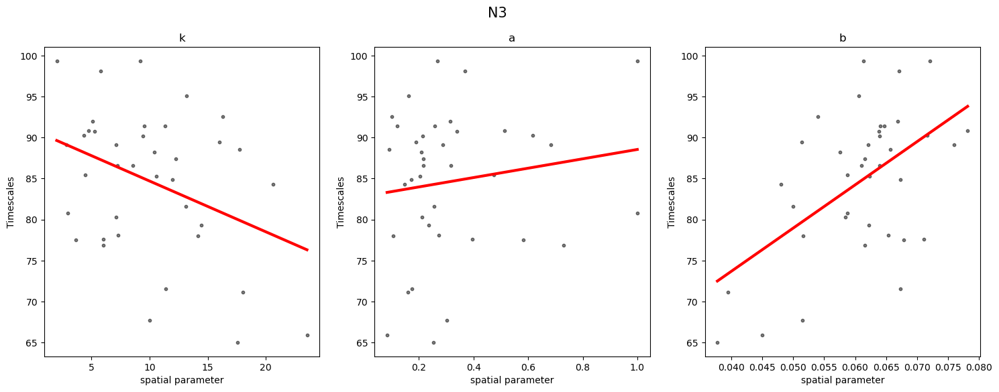

R k
Linregress LinregressResult(slope=0.23842823155987627, intercept=36.14137797759494, rvalue=0.25844993916258097, pvalue=0.11717929790747807, stderr=0.14853137532760344, intercept_stderr=2.6882033204637907)
Spearman SignificanceResult(statistic=0.22770543823175401, pvalue=0.16915595102373412)
R a
Linregress LinregressResult(slope=-11.400836885458965, intercept=42.60571682691838, rvalue=-0.21089445307058388, pvalue=0.20374132428160782, stderr=8.807264061421323, intercept_stderr=3.4456587976236928)
Spearman SignificanceResult(statistic=-0.10624794835321151, pvalue=0.5255076794716695)
R b
Linregress LinregressResult(slope=-544.8015546805292, intercept=62.95374984013343, rvalue=-0.37533091858546136, pvalue=0.020231890686709594, stderr=224.23394347392068, intercept_stderr=10.043681776621277)
Spearman SignificanceResult(statistic=-0.4126272021008863, pvalue=0.01003889909361679)


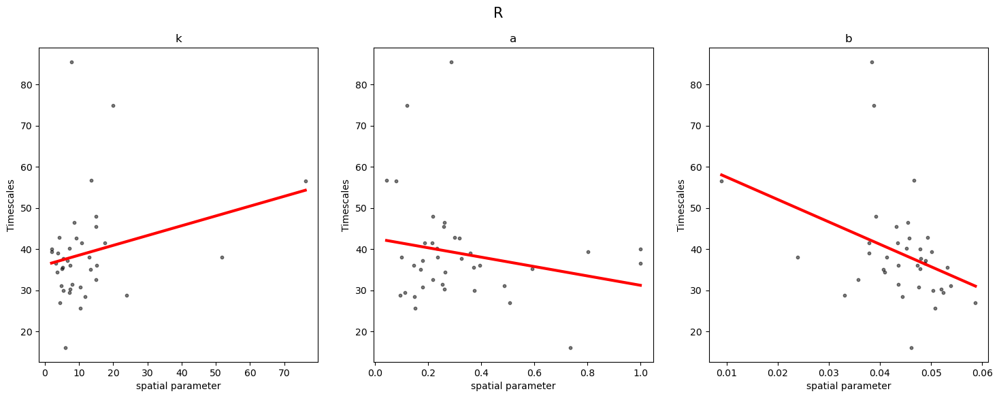

In [15]:
from scipy.stats import linregress, spearmanr
import statsmodels.formula.api as smf

for stage in ["W", "N3", "R"]:

    # Compute timescale per region
    data = df_tau[df_tau["stage"] == stage].copy()
    data.dropna(inplace=True)
    md = smf.mixedlm("tau ~ 0 + region", data, groups=data["pat"])
    mdf = md.fit()
    df_tau_stage = mdf.fe_params
    df_tau_stage.index = df_tau_stage.index.str.strip("region[").str.strip("]")

    # df_tau_stage = df_tau[df_tau["stage"] == stage]
    # df_tau_stage = df_tau_stage[["region", "tau"]].groupby("region").mean()
    plt.figure(figsize=[18,6])
    plt.suptitle(stage, fontsize=15)
    for i, param in enumerate(["k", "a", "b"]):

        df_spa = df_sc_params[df_sc_params["stage"] == stage].set_index("region")[param].astype(float)
        x = df_spa.loc[df_tau_stage.index].to_numpy()
        y = df_tau_stage.to_numpy().squeeze()
        res = linregress(x, y)
        print(stage, param)
        print("Linregress", res)
        print("Spearman", spearmanr(x, y))

        plt.subplot(1, 3, i+1)
        plt.scatter(x, y, c="k", alpha=0.5, s=10)
        plt.plot(
            [x.min(), x.max()],
            [
                res.intercept + res.slope * x.min(),
                res.intercept + res.slope * x.max(),
            ],
            "r",
            linewidth=3,
        )
        # plt.ylim(0, 200)
        plt.xlabel("spatial parameter")
        plt.ylabel("Timescales")
        plt.title(param)
    plt.show()

In [16]:
df_weights = pd.read_csv(base_path.joinpath("Results/W_max_W.csv"), index_col=0)
df_weights

,V1,MST,V6,V2,V3,V4,V8,4,3b,FEF,...,p47r,TGv,MBelt,LBelt,A4,STSva,TE1m,PI,a32pr,p24
1,3.394479e-13,5.235003e-13,3.210718e-31,4.915731e-10,9.376013e-16,4.800518e-13,6.174522e-25,2.177738e-18,3.614947e-16,2.217110e-34,...,4.089846e-15,1.913737e-38,2.420077e-01,9.892280e-01,0.156923,3.559369e-07,8.556265e-02,3.984321e-11,9.376013e-16,1.288629e-04
2,2.680321e-10,8.639620e-30,1.189170e-58,1.058207e-07,3.501313e-31,4.434220e-34,9.223081e-40,8.876882e-01,4.070069e-01,4.903831e-03,...,3.521676e-12,2.018369e-13,1.822397e-04,4.507745e-10,0.968031,1.138998e-05,4.915731e-10,5.087586e-02,1.671146e-04,6.390384e-17
3,6.597782e-02,4.232827e-07,3.161355e-22,1.866135e-01,1.866135e-01,8.876882e-01,1.143901e-04,4.391438e-06,3.932585e-09,1.105871e-27,...,3.079787e-18,3.719693e-27,9.680309e-01,1.866135e-01,0.684501,2.516854e-07,1.354505e-05,5.154517e-04,9.125409e-45,2.649414e-48
4,3.279816e-21,2.764678e-28,2.499921e-59,4.992487e-19,2.355393e-30,1.038427e-24,3.184425e-43,5.561515e-09,1.803098e-09,8.457603e-40,...,3.303751e-42,2.937114e-24,9.680309e-01,7.464539e-01,0.575595,1.438987e-01,8.556265e-02,9.680309e-01,1.026453e-62,4.477418e-62
5,1.987338e-04,4.391438e-06,3.430811e-08,1.288629e-04,1.803098e-09,2.757986e-21,4.481680e-29,1.197224e-06,7.763040e-07,7.015744e-23,...,2.549966e-09,4.143651e-17,8.876882e-01,5.278226e-01,0.887688,2.139066e-02,9.577795e-06,8.876882e-01,3.153702e-15,5.373651e-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,1.022373e-02,1.252541e-01,3.513383e-08,4.065138e-05,3.220900e-03,6.221911e-01,1.515623e-02,9.847135e-01,3.851812e-01,2.500726e-03,...,5.294263e-03,5.777503e-26,2.202745e-02,1.936176e-04,0.042279,2.765516e-08,3.651568e-01,1.839746e-02,3.728177e-01,1.470407e-03
107,1.749837e-33,6.724342e-18,2.775142e-35,1.337454e-36,1.167506e-44,1.391263e-41,3.001129e-36,3.187936e-01,3.471707e-03,2.221708e-11,...,9.846094e-01,1.639141e-23,1.894671e-03,8.883413e-03,0.994001,7.003509e-05,9.972961e-01,8.707312e-09,1.033372e-05,9.260378e-11
108,9.702597e-01,2.189379e-01,1.836063e-01,9.738144e-01,9.902536e-01,1.664289e-08,6.442202e-17,3.047656e-18,1.050278e-16,6.071573e-30,...,1.768956e-52,2.838351e-27,2.736260e-07,3.944323e-05,0.332141,5.294760e-01,9.821539e-01,2.877135e-09,3.188161e-116,4.489581e-118
109,1.417092e-03,2.920587e-01,4.182130e-20,6.696956e-02,9.795459e-01,3.857334e-01,9.568670e-01,1.046974e-07,8.940687e-08,1.757677e-11,...,5.151670e-04,3.645021e-35,6.068925e-06,7.016051e-03,0.945585,9.600798e-08,6.842370e-03,1.932080e-07,4.297773e-30,3.002684e-37


Electrode level:

In [25]:
# def pearsonr_2D(x, y):
#     """computes pearson correlation coefficient
#        where x is a 1D and y a 2D array"""

#     upper = np.sum((x - np.mean(x)) * (y - np.mean(y, axis=1)[:,None]), axis=1)
#     lower = np.sqrt(np.sum(np.power(x - np.mean(x), 2)) * np.sum(np.power(y - np.mean(y, axis=1)[:,None], 2), axis=1))
    
#     rho = upper / lower
    
#     return rho

from scipy.spatial.distance import pdist, squareform

In [20]:
data_test = data["Data_W"].T.copy()
data_test.shape

(1772, 13600)

In [28]:
df_tau[df_tau["stage"] == "W"].shape

(1772, 11)

In [40]:
# Correlation coefficients
rhos_test = 1 - squareform(pdist(data_test, metric="correlation"))
print(rhos_test.shape)

# Distances between channels
mni_coords = df_tau[df_tau["stage"] == "W"][["mni_x", "mni_y", "mni_z"]].to_numpy()
dists_test = squareform(pdist(mni_coords))
print(dists_test.shape)

(1772, 1772)
(1772, 1772)


In [41]:
subjects_dir = mne.datasets.sample.data_path() / "subjects"
mne.datasets.fetch_hcp_mmp_parcellation(subjects_dir=subjects_dir, verbose=True)
labels = mne.read_labels_from_annot(
    "fsaverage", "HCPMMP1", "lh", subjects_dir=subjects_dir
)

Reading labels from parcellation...
   read 181 labels from C:\Users\ricca\mne_data\MNE-sample-data\subjects\fsaverage\label\lh.HCPMMP1.annot


In [54]:
parc_com = [mne.vertex_to_mni(lab.center_of_mass(), hemis=0, subject="fsaverage") for lab in labels[1:]]
parc_com = np.array(parc_com)
parc_com.shape

(180, 3)

In [101]:
labels[1]

[autoreload of mni_utils failed: Traceback (most recent call last):
  File "c:\Users\ricca\anaconda3\envs\neural_dynamics\lib\site-packages\IPython\extensions\autoreload.py", line 261, in check
    superreload(m, reload, self.old_objects)
  File "c:\Users\ricca\anaconda3\envs\neural_dynamics\lib\site-packages\IPython\extensions\autoreload.py", line 459, in superreload
    module = reload(module)
  File "c:\Users\ricca\anaconda3\envs\neural_dynamics\lib\importlib\__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 879, in exec_module
  File "<frozen importlib._bootstrap_external>", line 1017, in get_code
  File "<frozen importlib._bootstrap_external>", line 947, in source_to_code
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "c:\Users\ricca\Projects\iEEG-timescales_sleep\Analysis\MNI\mni_utils.py", line 36
    mmp_label

<Label | fsaverage, 'L_10d_ROI-lh', lh : 867 vertices>

In [102]:
labels[1].name

'L_10d_ROI-lh'

In [104]:
labels[1].pos

array([[-0.01461672,  0.05943633,  0.01379522],
       [-0.0080295 ,  0.06438531, -0.00229914],
       [-0.00884907,  0.06227618,  0.00885774],
       ...,
       [-0.01064306,  0.05554769,  0.00223861],
       [-0.01123173,  0.05499616,  0.00265298],
       [-0.01180752,  0.05440692,  0.0029852 ]])

In [107]:
np.isclose(mne.vertex_to_mni(labels[1].vertices, hemis=0, subject="fsaverage"), labels[1].pos * 1000).mean()

1.0

In [136]:
def mni_to_mmp(mni_coord, hemis="left"):

    # Load MMP data
    subjects_dir = mne.datasets.sample.data_path() / "subjects"
    mne.datasets.fetch_hcp_mmp_parcellation(subjects_dir=subjects_dir, verbose=True)
    labels = mne.read_labels_from_annot(
        "fsaverage", "HCPMMP1", hemis[0] + "h", subjects_dir=subjects_dir, surf_name="inflated",
        verbose=False
    )

    # Loop through each label to find the closest vertex
    min_dists = [
        np.min(np.linalg.norm(label.pos * 1000 - mni_coord.reshape(1, -1), axis=1)) for label in labels[1:]
    ]
    closest_lab = labels[1:][np.argmin(min_dists)]

    return closest_lab.name[2:-7]

In [217]:
mni_coords = df_tau.loc[119, ["mni_x", "mni_y", "mni_z"]].to_numpy(dtype=float)
mni_coords

array([-42., -23.,  10.])

In [161]:
import nibabel as nib

MMP_data = nib.load(base_path.joinpath("MMP_in_MNI_symmetrical_1.nii.gz"))
MMP_map = MMP_data.get_fdata()
MMP_map_nonzero = np.array(np.where(MMP_map > 0)).T
MMP_map_nonzero_flat = MMP_map[np.where(MMP_map > 0)]

# Retrieve annotations files
subjects_dir = str(mne.datasets.sample.data_path()) + "/subjects"
parc_map_name = "HCPMMP1"
annot_file = (
    subjects_dir + "/fsaverage/label/lh." + parc_map_name + ".annot"
)
parc_labels, ctab, parc_names = nib.freesurfer.read_annot(annot_file)
region_names = [n[2:-4].decode("utf-8") for n in parc_names[1:]]

In [218]:
mni_coords_affine = uti.apply_affine(MMP_data.affine, mni_coords, False)
vertex_dists = np.linalg.norm(MMP_map_nonzero - mni_coords_affine.reshape(1, -1), axis=1)
vertex_dists.min()

0.8660254037844386

In [219]:
MMP_map_nonzero_flat[np.argsort(vertex_dists)[:5]]

array([ 24., 173., 173.,  24.,  24.])

In [220]:
region_names[int(MMP_map_nonzero_flat[np.argmin(vertex_dists)])]

'LBelt'

In [215]:
MMP_map_nonzero_flat[np.argmin(vertex_dists)]

120.0

In [223]:
region_names[24]

'PSL'

In [224]:
import statistics

statistics.mode(MMP_map_nonzero_flat[np.argsort(vertex_dists)[:5]])

24.0